In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from dython.nominal import associations
import gower
from kmodes.kprototypes import KPrototypes
from sklearn.cluster import AgglomerativeClustering, MeanShift, KMeans
import prince
from sklearn import metrics


In [2]:
import warnings
warnings.filterwarnings('ignore')

##  Import data

In [3]:
df = pd.read_csv('marketing_campaign.csv', sep = "\t")
df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,13-06-2013,46,709,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,10-06-2014,56,406,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,25-01-2014,91,908,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,24-01-2014,8,428,...,3,0,0,0,0,0,0,3,11,0


## EDA

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [5]:
df.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

In [6]:
# drop na for income since only a small number
df.dropna(subset=['Income'], inplace=True) 
df.isnull().sum()

ID                     0
Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Z_CostContact          0
Z_Revenue              0
Response               0
dtype: int64

In [7]:
df.nunique()

ID                     2216
Year_Birth               59
Education                 5
Marital_Status            8
Income                 1974
Kidhome                   3
Teenhome                  3
Dt_Customer             662
Recency                 100
MntWines                776
MntFruits               158
MntMeatProducts         554
MntFishProducts         182
MntSweetProducts        176
MntGoldProds            212
NumDealsPurchases        15
NumWebPurchases          15
NumCatalogPurchases      14
NumStorePurchases        14
NumWebVisitsMonth        16
AcceptedCmp3              2
AcceptedCmp4              2
AcceptedCmp5              2
AcceptedCmp1              2
AcceptedCmp2              2
Complain                  2
Z_CostContact             1
Z_Revenue                 1
Response                  2
dtype: int64

In [8]:
# Z_revenue and Z_costContact have the same value for all rows so drop that column 
df.drop(columns=['Z_Revenue', 'Z_CostContact'], inplace=True)
df.nunique()

ID                     2216
Year_Birth               59
Education                 5
Marital_Status            8
Income                 1974
Kidhome                   3
Teenhome                  3
Dt_Customer             662
Recency                 100
MntWines                776
MntFruits               158
MntMeatProducts         554
MntFishProducts         182
MntSweetProducts        176
MntGoldProds            212
NumDealsPurchases        15
NumWebPurchases          15
NumCatalogPurchases      14
NumStorePurchases        14
NumWebVisitsMonth        16
AcceptedCmp3              2
AcceptedCmp4              2
AcceptedCmp5              2
AcceptedCmp1              2
AcceptedCmp2              2
Complain                  2
Response                  2
dtype: int64

In [9]:
df.set_index('ID',inplace=True)

In [10]:
df.describe()

,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
count,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,...,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000
mean,1968.820397,52247.251354,0.441787,0.505415,49.012635,305.091606,26.356047,166.995939,37.637635,27.028881,...,2.671029,5.800993,5.319043,0.073556,0.074007,0.073105,0.064079,0.013538,0.009477,0.150271
std,11.985554,25173.076661,0.536896,0.544181,28.948352,337.327920,39.793917,224.283273,54.752082,41.072046,...,2.926734,3.250785,2.425359,0.261106,0.261842,0.260367,0.244950,0.115588,0.096907,0.357417
min,1893.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1959.000000,35303.000000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,3.000000,1.000000,...,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1970.000000,51381.500000,0.000000,0.000000,49.000000,174.500000,8.000000,68.000000,12.000000,8.000000,...,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1977.000000,68522.000000,1.000000,1.000000,74.000000,505.000000,33.000000,232.250000,50.000000,33.000000,...,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1996.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,...,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [11]:
df['Income'] = df['Income'].astype(int)

In [12]:
df.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response'],
      dtype='object')

In [13]:
# rename response to AcceptedCmp6
df.rename(columns={'Response': 'AcceptedCmp6'}, inplace=True)
df.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'AcceptedCmp6'],
      dtype='object')

In [14]:
# get year from Dt_Customer 
df['Joined_year'] = df['Dt_Customer'].str[-4:].astype(int)
df

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,...,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year
ID,,,,,,,,,,,,,,,,,,,,,
5524,1957,Graduation,Single,58138,0,0,04-09-2012,58,635,88,...,4,7,0,0,0,0,0,0,1,2012
2174,1954,Graduation,Single,46344,1,1,08-03-2014,38,11,1,...,2,5,0,0,0,0,0,0,0,2014
4141,1965,Graduation,Together,71613,0,0,21-08-2013,26,426,49,...,10,4,0,0,0,0,0,0,0,2013
6182,1984,Graduation,Together,26646,1,0,10-02-2014,26,11,4,...,4,6,0,0,0,0,0,0,0,2014
5324,1981,PhD,Married,58293,1,0,19-01-2014,94,173,43,...,6,5,0,0,0,0,0,0,0,2014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10870,1967,Graduation,Married,61223,0,1,13-06-2013,46,709,43,...,4,5,0,0,0,0,0,0,0,2013
4001,1946,PhD,Together,64014,2,1,10-06-2014,56,406,0,...,5,7,0,0,0,1,0,0,0,2014
7270,1981,Graduation,Divorced,56981,0,0,25-01-2014,91,908,48,...,13,6,0,1,0,0,0,0,0,2014


In [15]:
df.drop(columns=['Dt_Customer'], inplace=True)


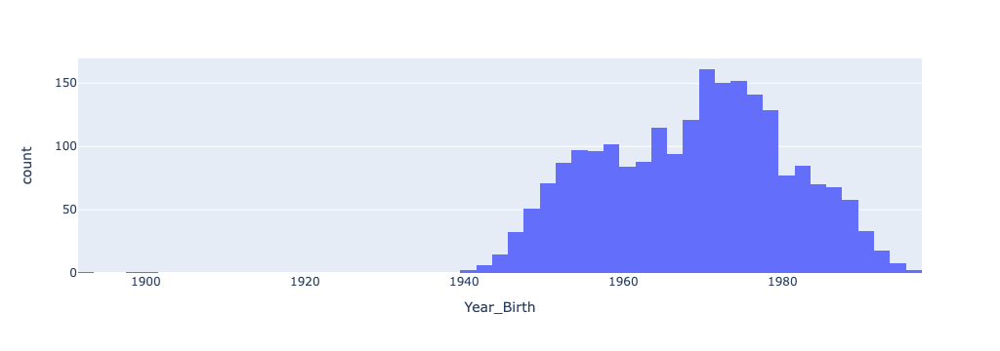

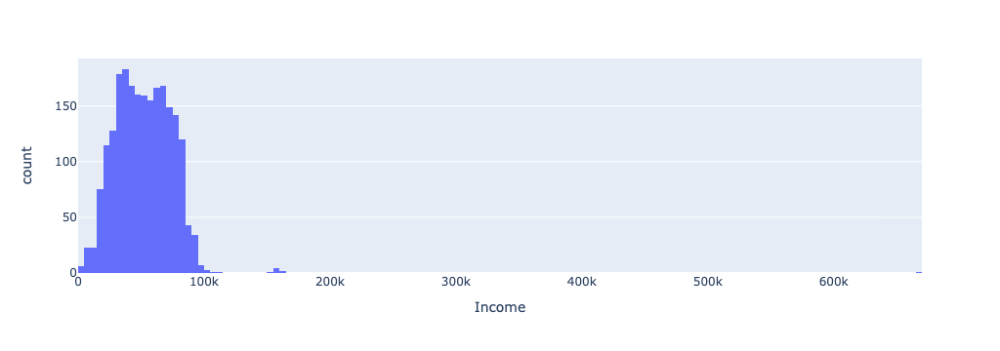

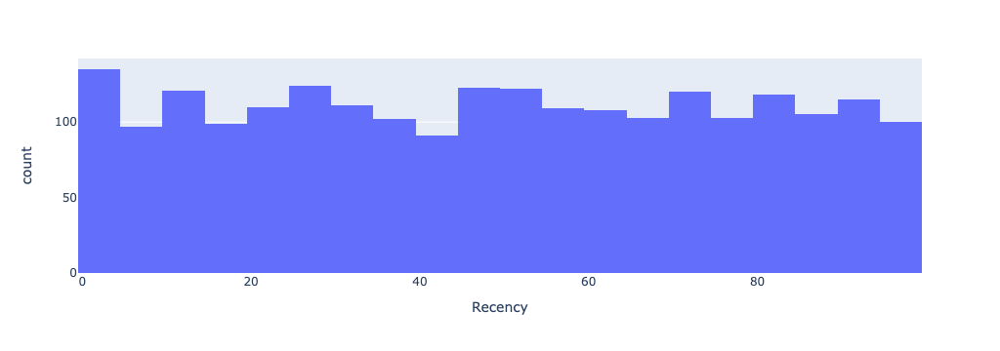

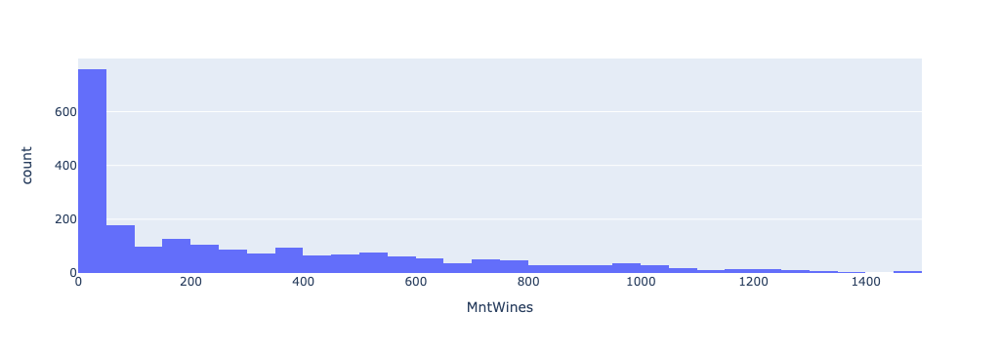

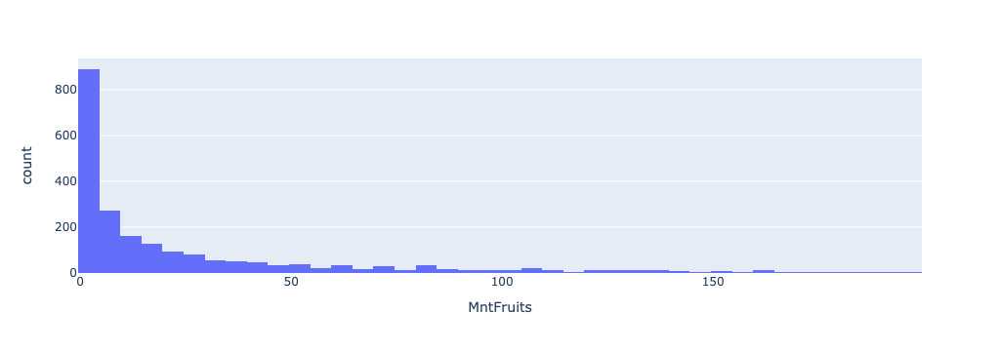

...

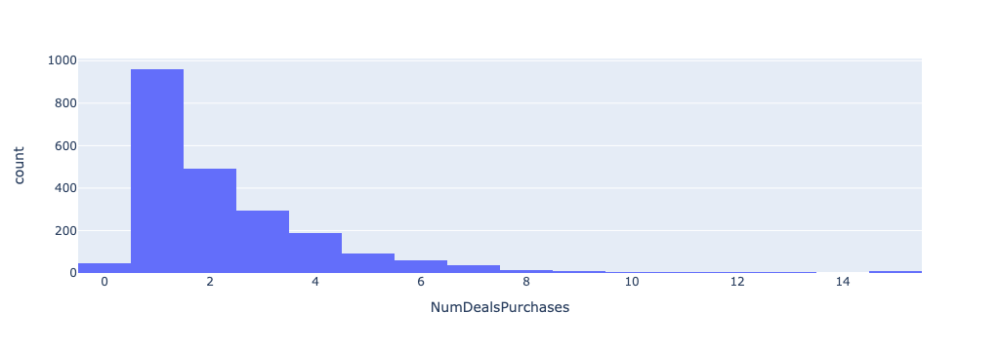

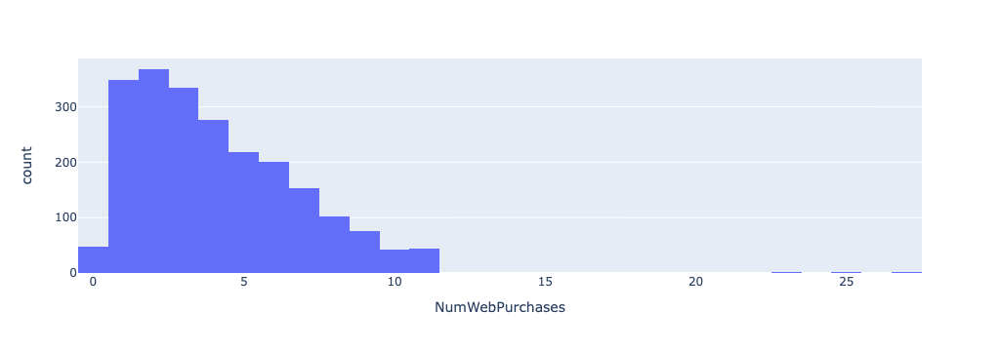

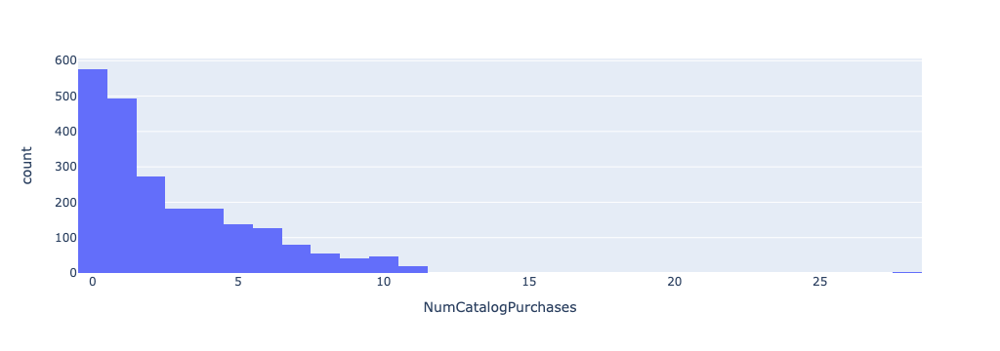

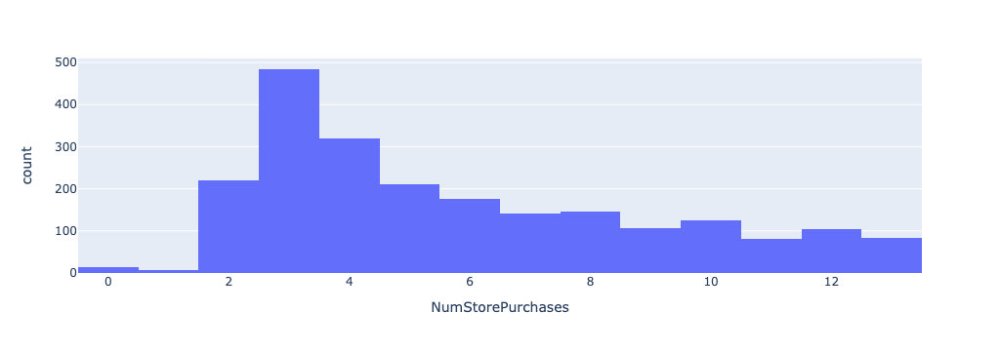

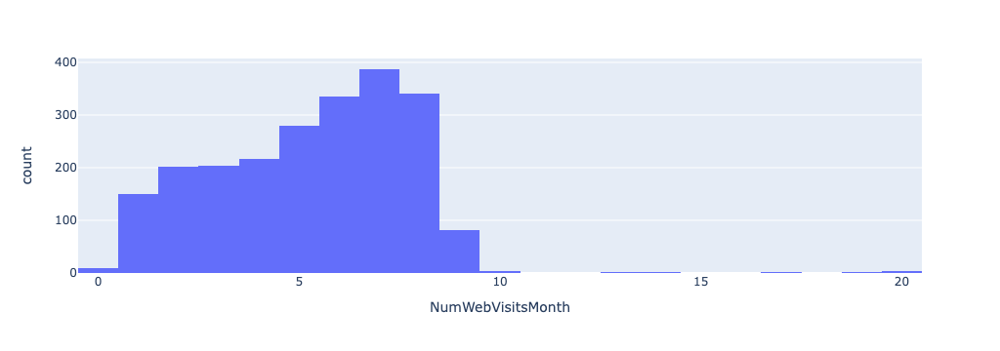

In [16]:
for i in df[['Year_Birth', 'Income', 'Recency','MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth']]: 
    fig = px.histogram(df, x=i)
    fig.show()

#### 1. Year Birth and convert to age

In [17]:
# check records  year_birth < 1940
df[df['Year_Birth'] < 1940]

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,...,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year
ID,,,,,,,,,,,,,,,,,,,,,
7829,1900,2n Cycle,Divorced,36640,1,0,99,15,6,8,...,2,5,0,0,0,0,0,1,0,2013
11004,1893,2n Cycle,Single,60182,0,1,23,8,0,5,...,2,4,0,0,0,0,0,0,0,2014
1150,1899,PhD,Together,83532,0,0,36,755,144,562,...,4,1,0,0,1,0,0,0,0,2013


In [18]:
# Drop year_birth < 190 since it is unlikely
df = df[df['Year_Birth'] >= 1940]
df

,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,...,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year
ID,,,,,,,,,,,,,,,,,,,,,
5524,1957,Graduation,Single,58138,0,0,58,635,88,546,...,4,7,0,0,0,0,0,0,1,2012
2174,1954,Graduation,Single,46344,1,1,38,11,1,6,...,2,5,0,0,0,0,0,0,0,2014
4141,1965,Graduation,Together,71613,0,0,26,426,49,127,...,10,4,0,0,0,0,0,0,0,2013
6182,1984,Graduation,Together,26646,1,0,26,11,4,20,...,4,6,0,0,0,0,0,0,0,2014
5324,1981,PhD,Married,58293,1,0,94,173,43,118,...,6,5,0,0,0,0,0,0,0,2014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10870,1967,Graduation,Married,61223,0,1,46,709,43,182,...,4,5,0,0,0,0,0,0,0,2013
4001,1946,PhD,Together,64014,2,1,56,406,0,30,...,5,7,0,0,0,1,0,0,0,2014
7270,1981,Graduation,Divorced,56981,0,0,91,908,48,217,...,13,6,0,1,0,0,0,0,0,2014


In [19]:
# Convert Year_Birth to age_group for more meaningful profile of customers

df['Age'] = 2023 - df['Year_Birth']



In [20]:
df.drop(columns=['Year_Birth'], inplace=True)


#### 2. Drop income more than 600k since its the only one that is so high

In [21]:
df[df['Income'] > 600000]

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year,Age
ID,,,,,,,,,,,,,,,,,,,,,
9432,Graduation,Together,666666,1,0,23,9,14,18,8,...,6,0,0,0,0,0,0,0,2013,46


In [22]:
df = df[df['Income'] < 600000]

#### 3. Combine campaign columns into one -- number of campaigns participated

In [23]:
df['NumCmp'] = df['AcceptedCmp3'] + df['AcceptedCmp4'] + df['AcceptedCmp5'] + df['AcceptedCmp1'] + df['AcceptedCmp2'] + df['AcceptedCmp6']
df

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year,Age,NumCmp
ID,,,,,,,,,,,,,,,,,,,,,
5524,Graduation,Single,58138,0,0,58,635,88,546,172,...,0,0,0,0,0,0,1,2012,66,1
2174,Graduation,Single,46344,1,1,38,11,1,6,2,...,0,0,0,0,0,0,0,2014,69,0
4141,Graduation,Together,71613,0,0,26,426,49,127,111,...,0,0,0,0,0,0,0,2013,58,0
6182,Graduation,Together,26646,1,0,26,11,4,20,10,...,0,0,0,0,0,0,0,2014,39,0
5324,PhD,Married,58293,1,0,94,173,43,118,46,...,0,0,0,0,0,0,0,2014,42,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10870,Graduation,Married,61223,0,1,46,709,43,182,42,...,0,0,0,0,0,0,0,2013,56,0
4001,PhD,Together,64014,2,1,56,406,0,30,0,...,0,0,0,1,0,0,0,2014,77,1
7270,Graduation,Divorced,56981,0,0,91,908,48,217,32,...,0,1,0,0,0,0,0,2014,42,1


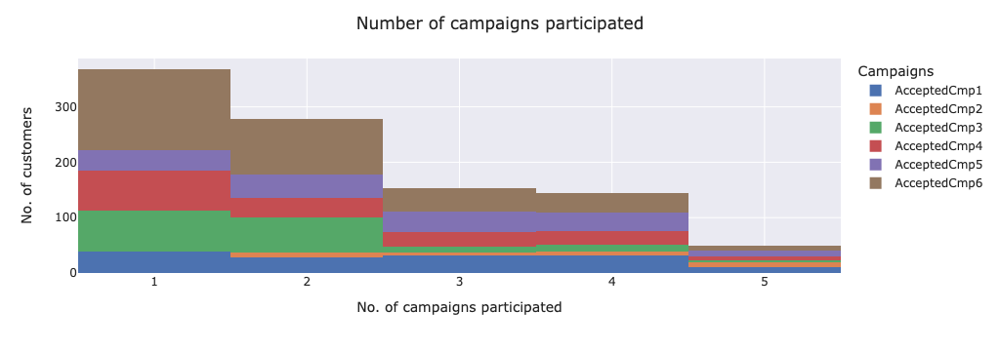

In [24]:
fig = px.histogram(df, x="NumCmp", y=['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4','AcceptedCmp5', 'AcceptedCmp6'], template='seaborn')


fig.update_layout(
    title="Number of campaigns participated",
    xaxis_title="No. of campaigns participated",
    yaxis_title="No. of customers",
    legend_title="Campaigns",

    
)

fig.show()

### Cateogrical frequency

In [25]:
df.columns

Index(['Education', 'Marital_Status', 'Income', 'Kidhome', 'Teenhome',
       'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'AcceptedCmp6', 'Joined_year', 'Age', 'NumCmp'],
      dtype='object')

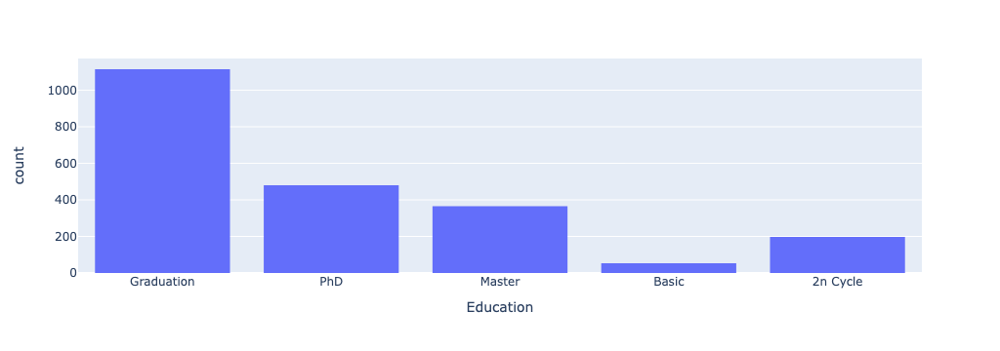

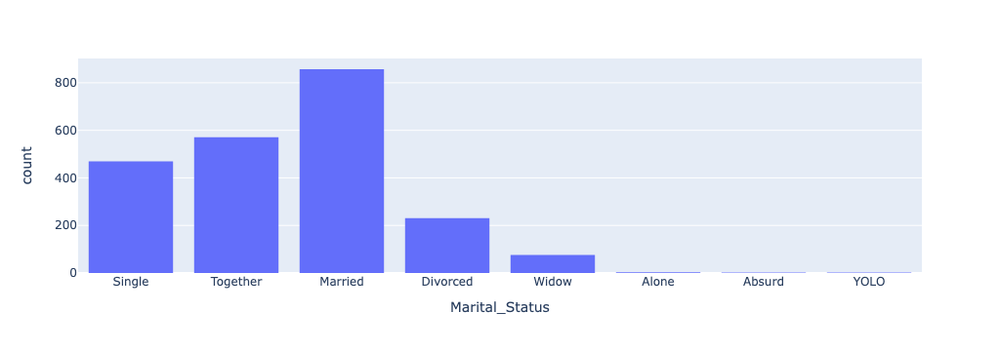

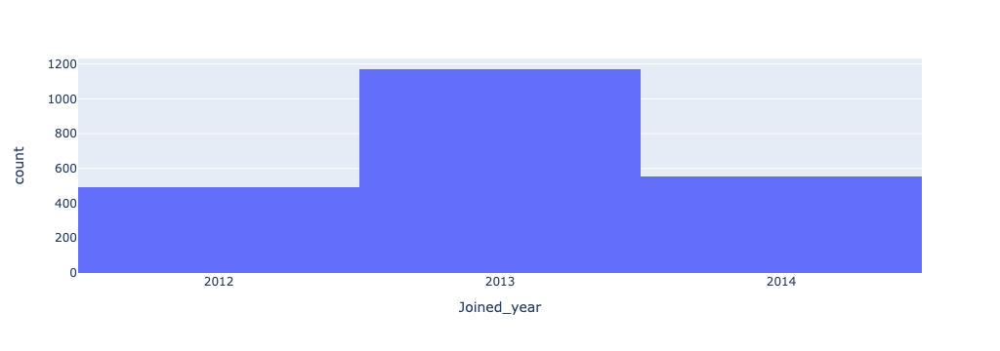

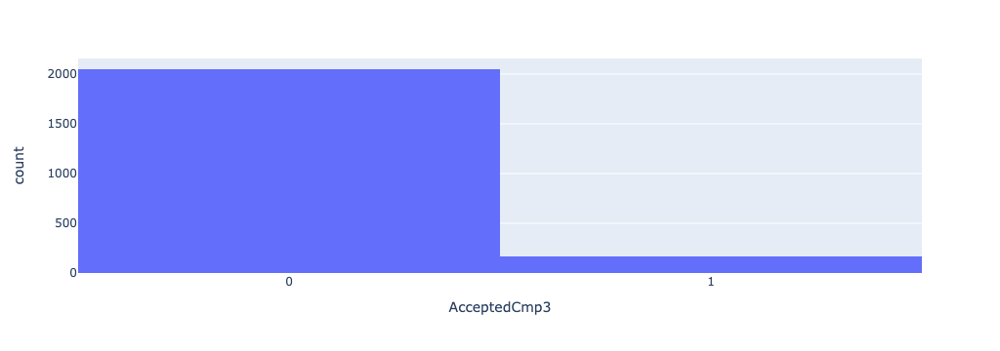

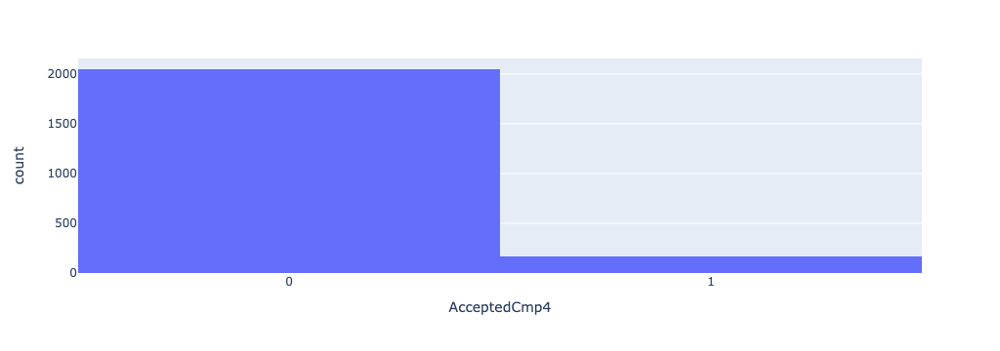

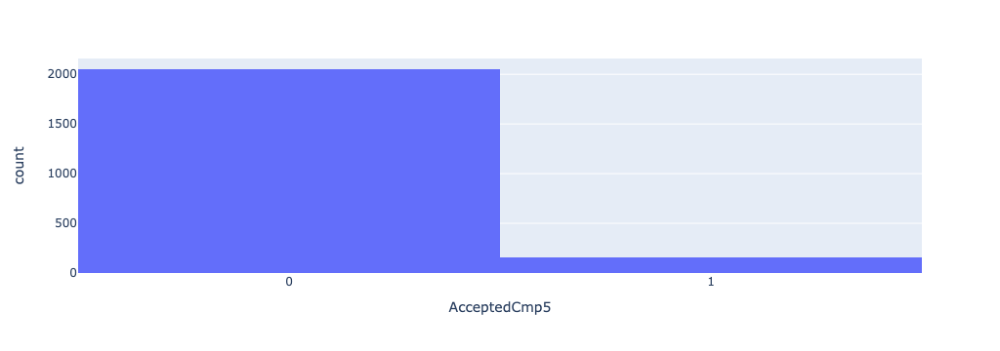

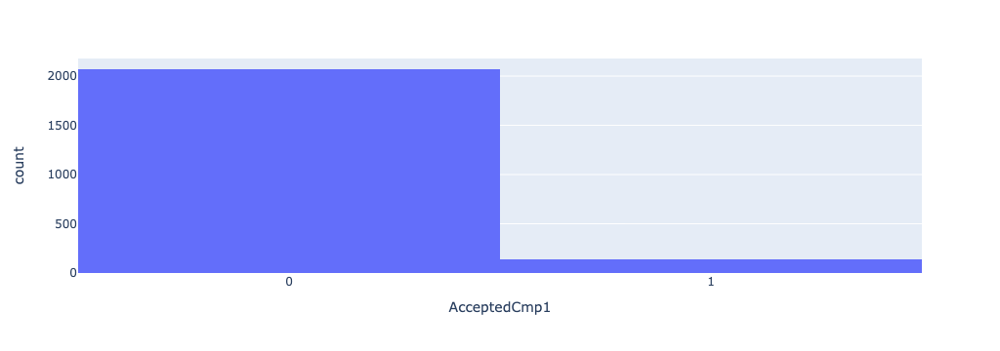

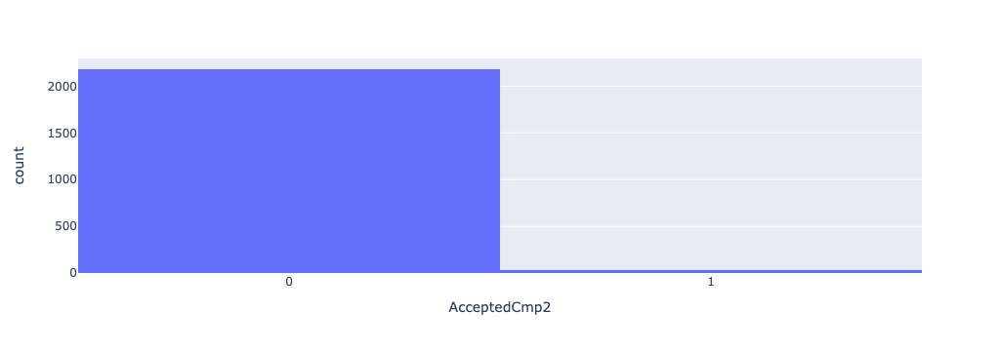

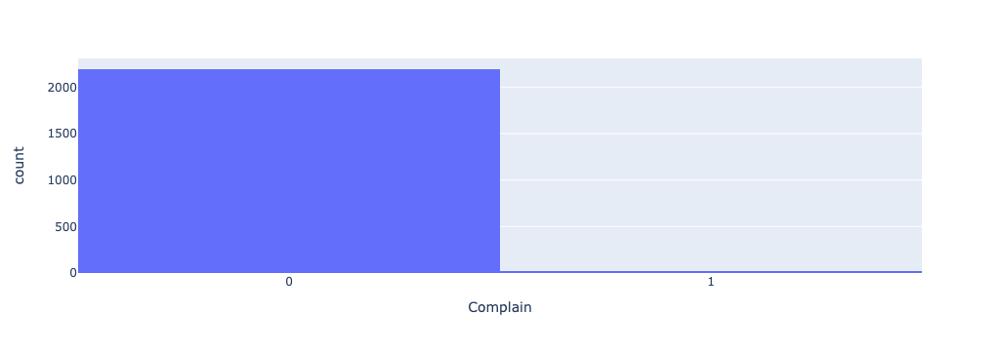

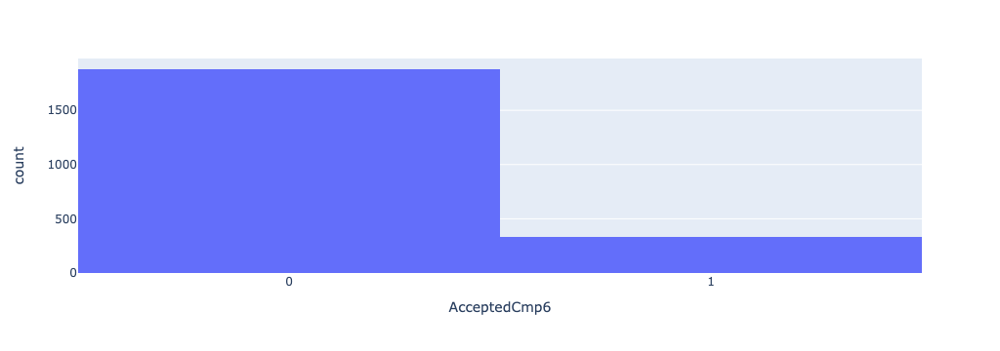

In [26]:
X_cat = df[['Education', 'Marital_Status', 'Joined_year',  'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'AcceptedCmp6']]

for i in X_cat:
    fig = px.histogram(X_cat, x=i)
    
    if len(X_cat[i].unique()) < 5:
        fig.update_layout(
            xaxis = dict(
                tickmode = 'array',
                tickvals = X_cat[i].unique(),
                ticktext = X_cat[i].unique()
            )
        )
    
    fig.show()

In [27]:
# Not sure what Graduation, Basic and 2n cycle are so decided to drop 
df.drop(columns=['Education'], inplace=True)

In [28]:
df[df['Marital_Status'].isin(['Alone','Absurd','YOLO'])]

,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year,Age,NumCmp
ID,,,,,,,,,,,,,,,,,,,,,
433,Alone,61331,1,1,42,534,5,47,0,5,...,0,0,0,0,0,0,0,2013,65,0
7660,Alone,35860,1,1,37,15,0,8,4,2,...,1,0,0,0,0,0,1,2014,50,2
92,Alone,34176,1,0,12,5,7,24,19,14,...,0,0,0,0,0,0,0,2014,35,0
7734,Absurd,79244,0,0,58,471,102,125,212,61,...,0,0,1,1,0,0,1,2012,30,3
4369,Absurd,65487,0,0,48,240,67,500,199,0,...,0,0,0,0,0,0,0,2014,66,0
492,YOLO,48432,0,1,3,322,3,50,4,3,...,0,0,0,0,0,0,0,2012,50,0
11133,YOLO,48432,0,1,3,322,3,50,4,3,...,0,0,0,0,0,0,1,2012,50,1


In [29]:
# drop maritial status == absurd or yolo as cannot tell if customer has a partner or not
df = df[df['Marital_Status'].isin(['Absurd','YOLO']) == False]
df

,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year,Age,NumCmp
ID,,,,,,,,,,,,,,,,,,,,,
5524,Single,58138,0,0,58,635,88,546,172,88,...,0,0,0,0,0,0,1,2012,66,1
2174,Single,46344,1,1,38,11,1,6,2,1,...,0,0,0,0,0,0,0,2014,69,0
4141,Together,71613,0,0,26,426,49,127,111,21,...,0,0,0,0,0,0,0,2013,58,0
6182,Together,26646,1,0,26,11,4,20,10,3,...,0,0,0,0,0,0,0,2014,39,0
5324,Married,58293,1,0,94,173,43,118,46,27,...,0,0,0,0,0,0,0,2014,42,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10870,Married,61223,0,1,46,709,43,182,42,118,...,0,0,0,0,0,0,0,2013,56,0
4001,Together,64014,2,1,56,406,0,30,0,0,...,0,0,0,1,0,0,0,2014,77,1
7270,Divorced,56981,0,0,91,908,48,217,32,12,...,0,1,0,0,0,0,0,2014,42,1


In [30]:
df['Marital_Status'].unique()

array(['Single', 'Together', 'Married', 'Divorced', 'Widow', 'Alone'],
      dtype=object)

In [31]:
# create partner column if customer has partner or not. Drop marital status since not useful for analysis as some labels like alone has only 3 customers

df['Partner'] = np.where(df['Marital_Status'].isin(['Alone', 'Single', 'Divorced', 'Widow']), 'No', 'Yes')
df

,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,...,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year,Age,NumCmp,Partner
ID,,,,,,,,,,,,,,,,,,,,,
5524,Single,58138,0,0,58,635,88,546,172,88,...,0,0,0,0,0,1,2012,66,1,No
2174,Single,46344,1,1,38,11,1,6,2,1,...,0,0,0,0,0,0,2014,69,0,No
4141,Together,71613,0,0,26,426,49,127,111,21,...,0,0,0,0,0,0,2013,58,0,Yes
6182,Together,26646,1,0,26,11,4,20,10,3,...,0,0,0,0,0,0,2014,39,0,Yes
5324,Married,58293,1,0,94,173,43,118,46,27,...,0,0,0,0,0,0,2014,42,0,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10870,Married,61223,0,1,46,709,43,182,42,118,...,0,0,0,0,0,0,2013,56,0,Yes
4001,Together,64014,2,1,56,406,0,30,0,0,...,0,0,1,0,0,0,2014,77,1,Yes
7270,Divorced,56981,0,0,91,908,48,217,32,12,...,1,0,0,0,0,0,2014,42,1,No


In [32]:
df.drop(columns=['Marital_Status'], inplace=True)
df

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,...,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Joined_year,Age,NumCmp,Partner
ID,,,,,,,,,,,,,,,,,,,,,
5524,58138,0,0,58,635,88,546,172,88,88,...,0,0,0,0,0,1,2012,66,1,No
2174,46344,1,1,38,11,1,6,2,1,6,...,0,0,0,0,0,0,2014,69,0,No
4141,71613,0,0,26,426,49,127,111,21,42,...,0,0,0,0,0,0,2013,58,0,Yes
6182,26646,1,0,26,11,4,20,10,3,5,...,0,0,0,0,0,0,2014,39,0,Yes
5324,58293,1,0,94,173,43,118,46,27,15,...,0,0,0,0,0,0,2014,42,0,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10870,61223,0,1,46,709,43,182,42,118,247,...,0,0,0,0,0,0,2013,56,0,Yes
4001,64014,2,1,56,406,0,30,0,0,8,...,0,0,1,0,0,0,2014,77,1,Yes
7270,56981,0,0,91,908,48,217,32,12,24,...,1,0,0,0,0,0,2014,42,1,No


In [33]:
# Drop AcceptedCmp1-6 and complain since the number of customer for one of the two groups is too small


df.drop(columns=['AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2','AcceptedCmp6', 'Complain'], inplace=True)


In [34]:
df['Joined_year'].value_counts()/len(df.index)

Joined_year
2013    0.529891
2014    0.249547
2012    0.220562
Name: count, dtype: float64

In [35]:
df

,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Joined_year,Age,NumCmp,Partner
ID,,,,,,,,,,,,,,,,,,,
5524,58138,0,0,58,635,88,546,172,88,88,3,8,10,4,7,2012,66,1,No
2174,46344,1,1,38,11,1,6,2,1,6,2,1,1,2,5,2014,69,0,No
4141,71613,0,0,26,426,49,127,111,21,42,1,8,2,10,4,2013,58,0,Yes
6182,26646,1,0,26,11,4,20,10,3,5,2,2,0,4,6,2014,39,0,Yes
5324,58293,1,0,94,173,43,118,46,27,15,5,5,3,6,5,2014,42,0,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10870,61223,0,1,46,709,43,182,42,118,247,2,9,3,4,5,2013,56,0,Yes
4001,64014,2,1,56,406,0,30,0,0,8,7,8,2,5,7,2014,77,1,Yes
7270,56981,0,0,91,908,48,217,32,12,24,1,2,3,13,6,2014,42,1,No


### Data Visualisation

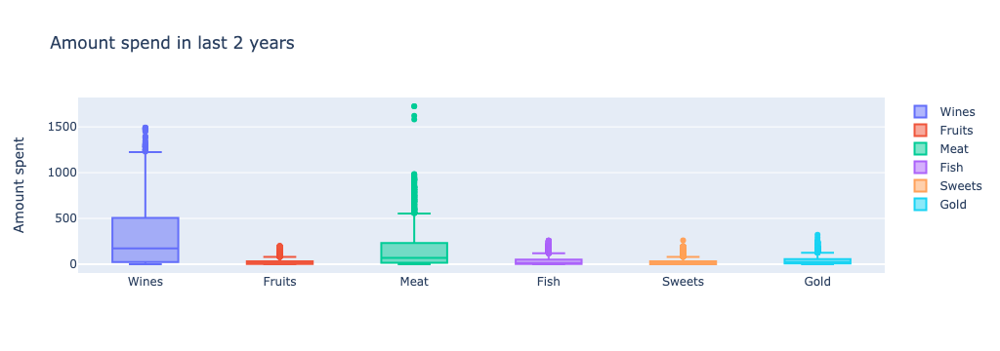

In [36]:
# Products 
fig = go.Figure()
fig.add_trace(go.Box(y=df['MntWines'], name='Wines'))
fig.add_trace(go.Box(y=df['MntFruits'], name='Fruits'))
fig.add_trace(go.Box(y=df['MntMeatProducts'], name='Meat'))
fig.add_trace(go.Box(y=df['MntFishProducts'], name='Fish'))
fig.add_trace(go.Box(y=df['MntSweetProducts'], name='Sweets'))
fig.add_trace(go.Box(y=df['MntGoldProds'], name='Gold'))

fig.update_layout(title_text="Amount spend in last 2 years", yaxis_title = 'Amount spent')
fig.show()


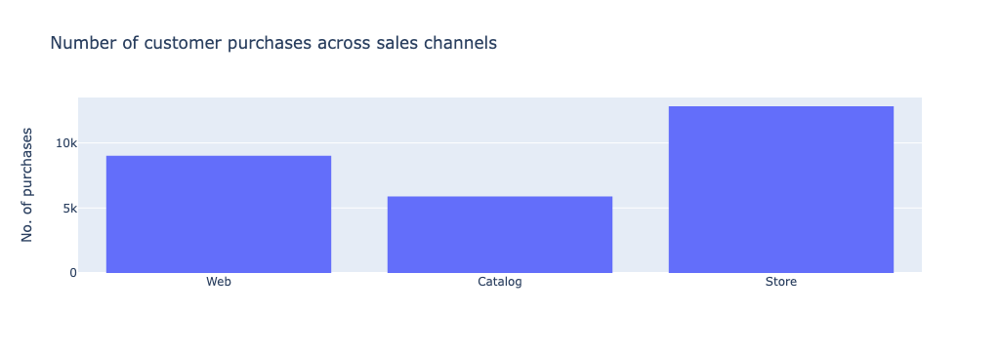

In [37]:
# Purchases 

x = []
y = []

for i in ['NumWebPurchases','NumCatalogPurchases', 'NumStorePurchases']:
    x.append(i[3:-9])
    y.append(df[i].sum())

fig = go.Figure()
fig.add_trace(go.Histogram(histfunc="sum", y=y, x=x, name="sum"))
fig.update_layout(title_text="Number of customer purchases across sales channels", yaxis_title = 'No. of purchases')

fig.show()


In [38]:
df['NumStorePurchases'].sum()/sum(y)

0.4621957815035154

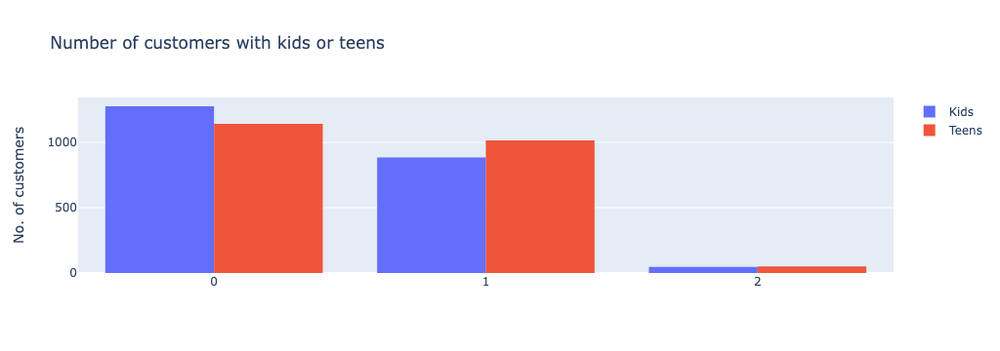

In [39]:
fig = go.Figure()
fig.add_trace(go.Histogram(histfunc="count", x=df['Kidhome'], name="Kids"))
fig.add_trace(go.Histogram(histfunc="count", x=df['Teenhome'], name="Teens"))
fig.update_layout(title_text="Number of customers with kids or teens", yaxis_title = 'No. of customers')


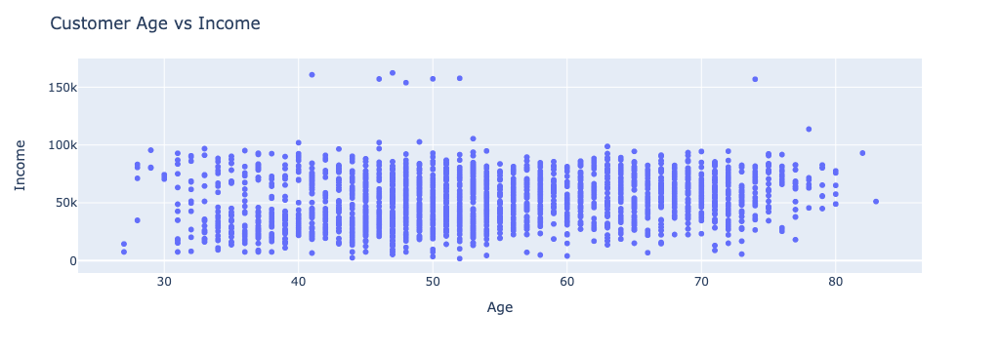

In [40]:
fig = px.scatter(df, x="Age", y="Income")
fig.update_layout(title_text="Customer Age vs Income")

fig.show()

## Feature Selection

### Correlation

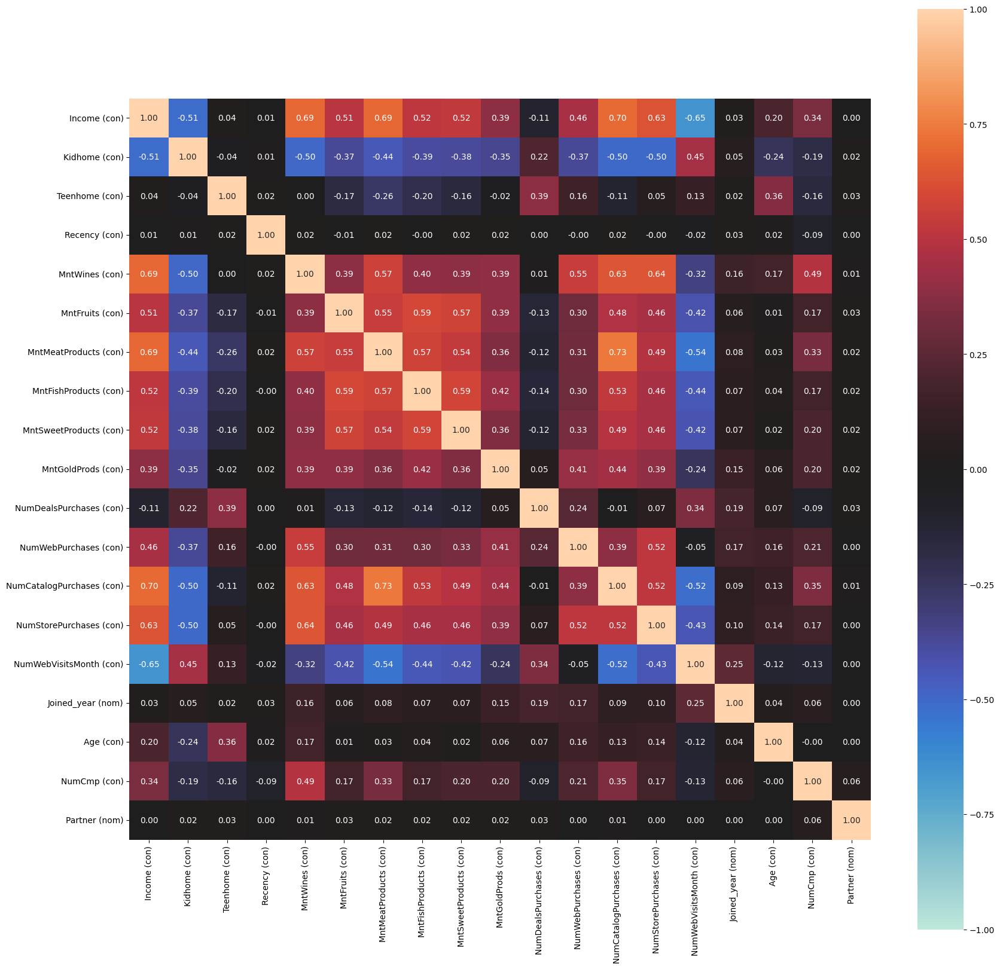

Associations ranking:
MntMeatProducts (con)      NumCatalogPurchases (con)    0.734914
Income (con)               NumCatalogPurchases (con)    0.696356
                           MntMeatProducts (con)        0.692645
                           MntWines (con)               0.688354
MntWines (con)             NumStorePurchases (con)      0.640203
                                                          ...   
Kidhome (con)              NumCatalogPurchases (con)   -0.504967
Income (con)               Kidhome (con)               -0.514493
NumCatalogPurchases (con)  NumWebVisitsMonth (con)     -0.520714
MntMeatProducts (con)      NumWebVisitsMonth (con)     -0.539157
Income (con)               NumWebVisitsMonth (con)     -0.650086
Length: 171, dtype: float64


In [41]:
association_dictionary = associations(df,nominal_columns=['Partner', 'Joined_year'], mark_columns = True, 
                 figsize= (20, 20))

print('Associations ranking:')
corr = association_dictionary['corr'].stack()
corr = corr[corr.index.get_level_values(0) < corr.index.get_level_values(1)]
corr = corr.sort_values(ascending = False)
print(corr)

### Variance threshold

In [42]:
df.columns

Index(['Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'Joined_year', 'Age', 'NumCmp', 'Partner'],
      dtype='object')

In [43]:
X_num = df[['Income', 'Kidhome', 'Teenhome',
       'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'Age' ,'NumCmp']]

In [44]:
X_num.shape

(2208, 17)

In [45]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import VarianceThreshold

scaler = MinMaxScaler()
X_num[X_num.columns] = scaler.fit_transform(X_num[X_num.columns])

selector = VarianceThreshold(threshold=0.04) # choose a treshold that half the number of variables
X_reduced = selector.fit_transform(X_num)
X_reduced.shape


(2208, 7)

In [46]:
selector.variances_.round(5)

array([0.01796, 0.07209, 0.07404, 0.08539, 0.05111, 0.03984, 0.0169 ,
       0.04439, 0.02461, 0.02574, 0.01645, 0.01032, 0.01091, 0.06262,
       0.01468, 0.04361, 0.03181])

In [47]:

cols = selector.get_support(indices=True)
selected_columns = X_num.iloc[:,cols].columns.tolist()
selected_columns


['Kidhome',
 'Teenhome',
 'Recency',
 'MntWines',
 'MntFishProducts',
 'NumStorePurchases',
 'Age']

## Data preperation for modeling

In [48]:
#selected_columns.extend(['Education', 'Marital_Status'])
X = pd.concat([X_num[selected_columns], df[['Partner','Joined_year']]], axis=1)
X

,Kidhome,Teenhome,Recency,MntWines,MntFishProducts,NumStorePurchases,Age,Partner,Joined_year
ID,,,,,,,,,
5524,0.0,0.0,0.585859,0.425318,0.664093,0.307692,0.696429,No,2012
2174,0.5,0.5,0.383838,0.007368,0.007722,0.153846,0.750000,No,2014
4141,0.0,0.0,0.262626,0.285332,0.428571,0.769231,0.553571,Yes,2013
6182,0.5,0.0,0.262626,0.007368,0.038610,0.307692,0.214286,Yes,2014
5324,0.5,0.0,0.949495,0.115874,0.177606,0.461538,0.267857,Yes,2014
...,...,...,...,...,...,...,...,...,...
10870,0.0,0.5,0.464646,0.474883,0.162162,0.307692,0.517857,Yes,2013
4001,1.0,0.5,0.565657,0.271936,0.000000,0.384615,0.892857,Yes,2014
7270,0.0,0.0,0.919192,0.608171,0.123552,1.000000,0.267857,No,2014


### KPrototype

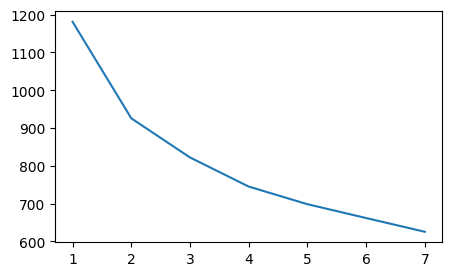

In [49]:
cost = []
for num_clusters in list(range(1,8)):
    kproto = KPrototypes(n_clusters=num_clusters, init='Huang')
    kproto.fit_predict(X, categorical=[7,8])
    cost.append(kproto.cost_)
    
plt.rcParams['figure.figsize'] = (5,3) 
plt.plot(range(1,8), cost)

In [50]:
kproto = KPrototypes(n_clusters=4, init='Huang', random_state=42) 
clusters = kproto.fit_predict(X, categorical=[7,8])

In [51]:
unique, counts = np.unique(clusters, return_counts=True)
value = dict(zip(unique, counts))
print('No. of customers in each cluster:', value)

No. of customers in each cluster: {0: 606, 1: 551, 2: 645, 3: 406}


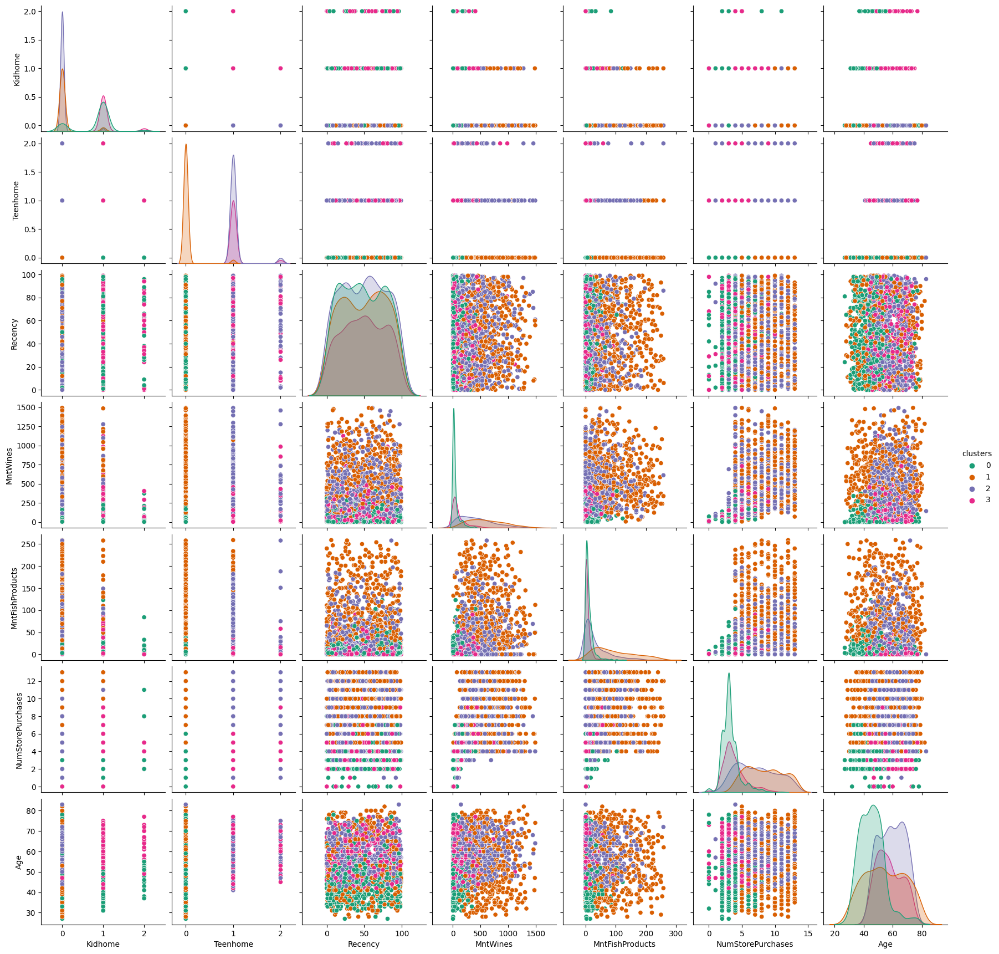

In [52]:
labels = clusters
kproto_df = df[selected_columns].copy()
kproto_df['clusters'] = labels

sns.pairplot(kproto_df,hue='clusters',palette='Dark2')

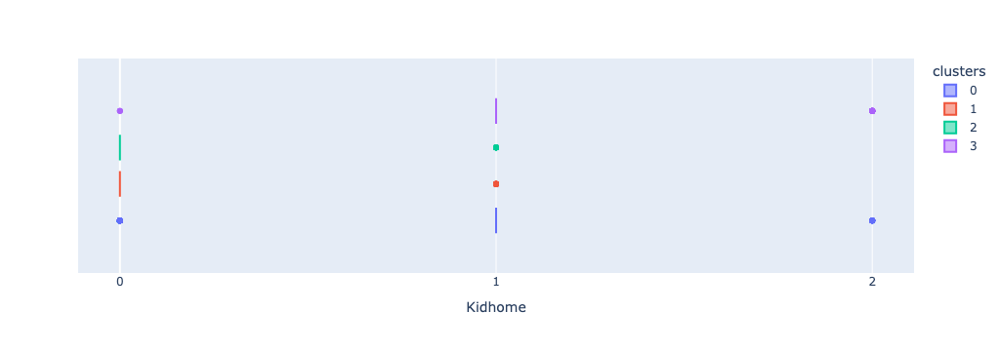

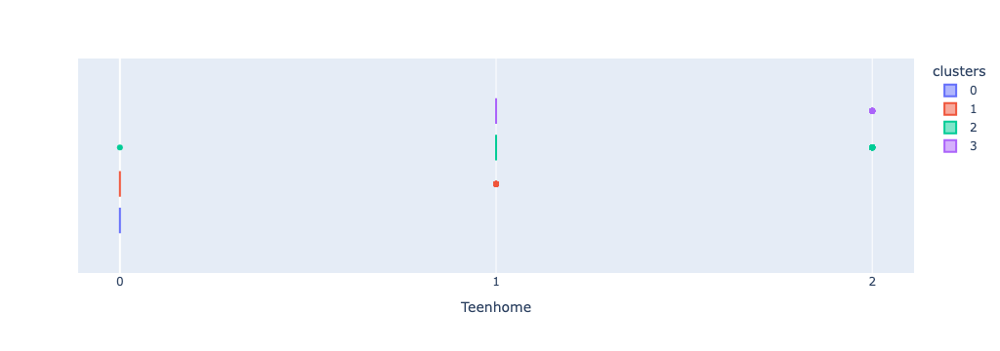

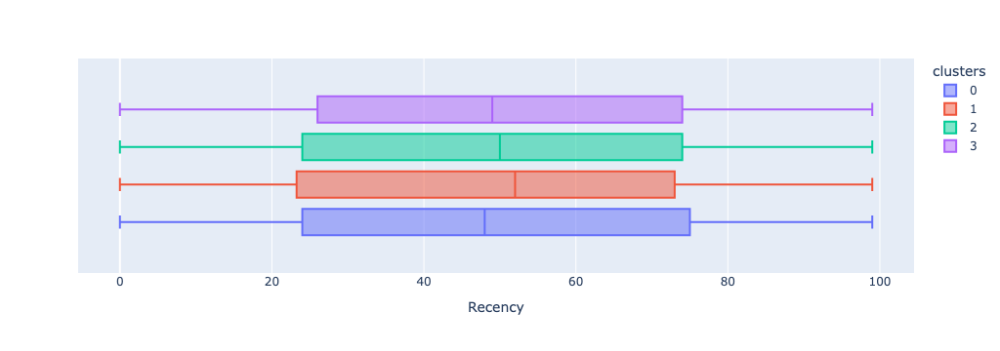

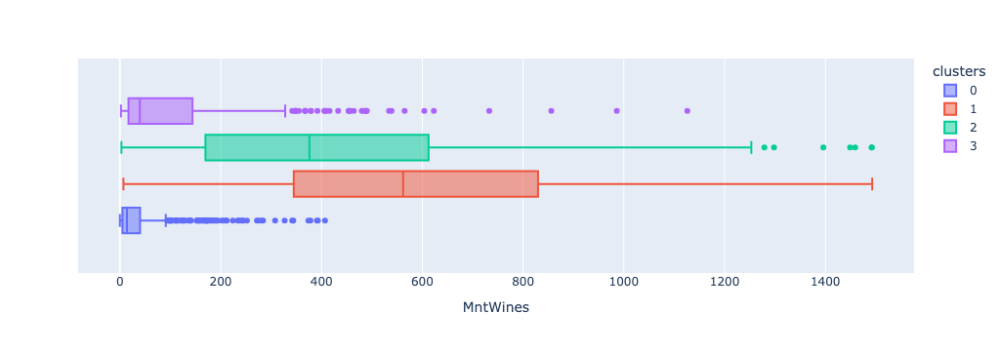

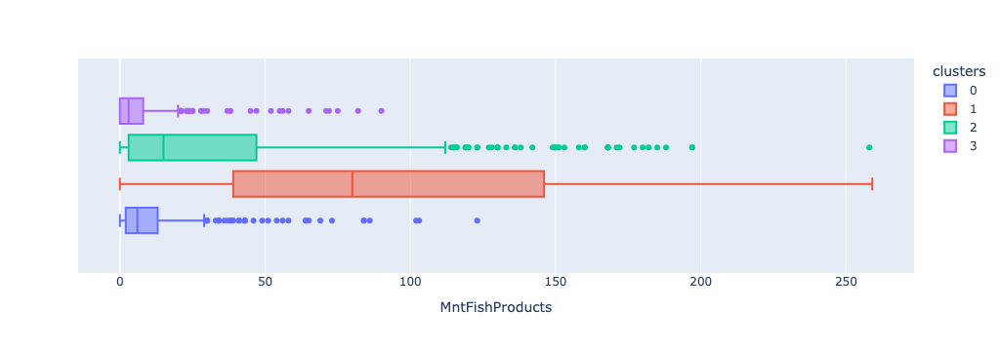

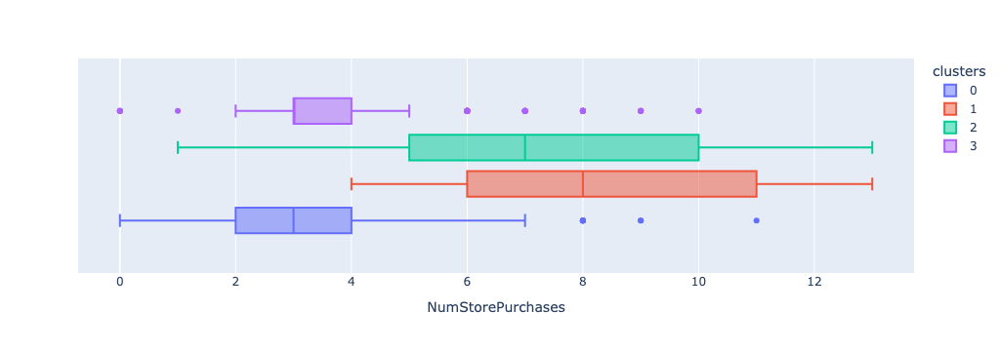

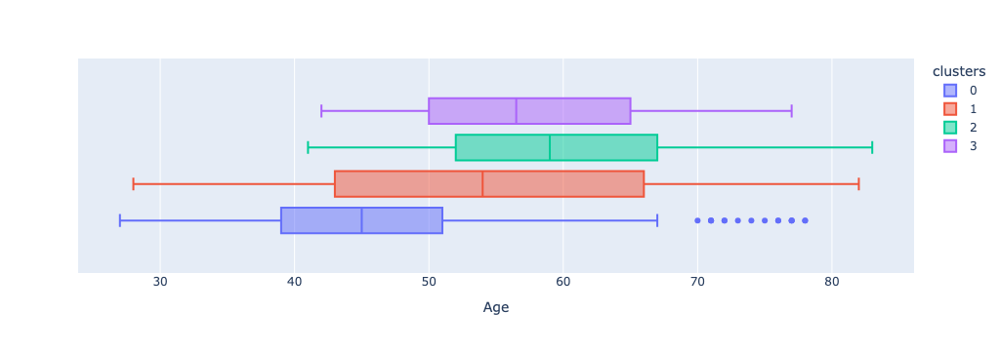

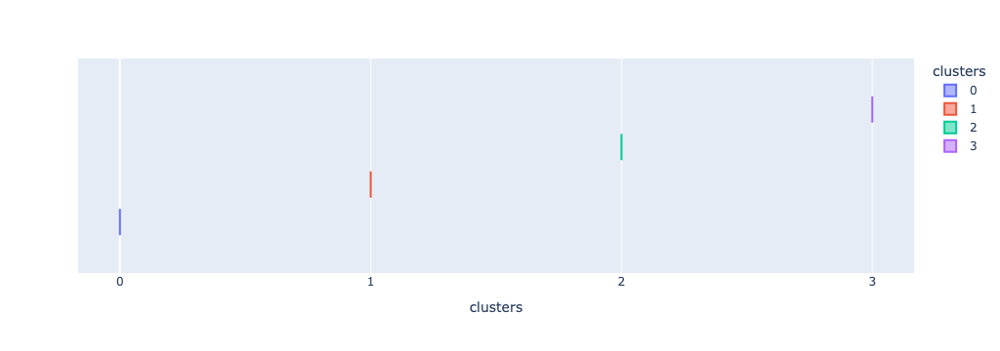

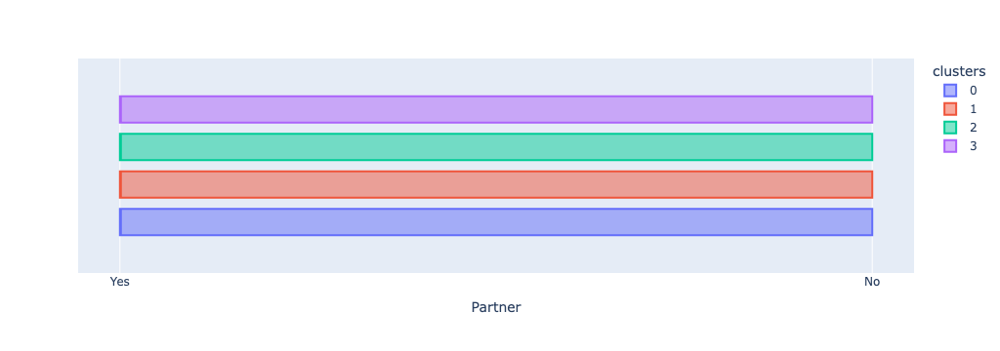

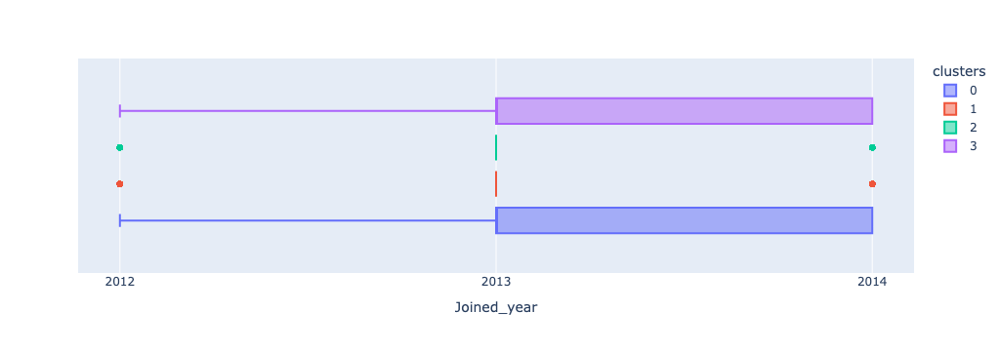

In [53]:
kproto_df = pd.concat([kproto_df, df[['Partner','Joined_year']]], axis=1)

kproto_df.sort_values(by=['clusters'], inplace=True)
for i in kproto_df.columns:
    fig = px.box(kproto_df, x=i, color='clusters')

    if len(kproto_df[i].unique()) < 5:
        fig.update_layout(
            xaxis = dict(
                tickmode = 'array',
                tickvals = kproto_df[i].unique(),
                ticktext = kproto_df[i].unique()
            )
        )
        
    fig.show()



### Get gower distance

In [54]:
X_gower = pd.concat([df[selected_columns], df[[ 'Partner','Joined_year']]], axis=1)
gower_dist = gower.gower_matrix(X_gower)
gower_dist

array([[0.        , 0.3870816 , 0.31145817, ..., 0.35306466, 0.44203123,
        0.36231288],
       [0.3870816 , 0.        , 0.4590918 , ..., 0.39780936, 0.33717677,
        0.24699095],
       [0.31145817, 0.4590918 , 0.        , ..., 0.36676624, 0.16261677,
        0.3276986 ],
       ...,
       [0.35306466, 0.39780936, 0.36676624, ..., 0.        , 0.3913789 ,
        0.5952574 ],
       [0.44203123, 0.33717677, 0.16261677, ..., 0.3913789 , 0.        ,
        0.31689194],
       [0.36231288, 0.24699095, 0.3276986 , ..., 0.5952574 , 0.31689194,
        0.        ]], dtype=float32)

### DBSCAN

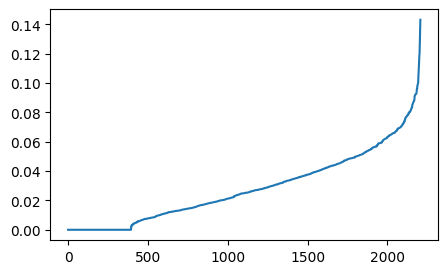

In [55]:
#selection of eps value
from sklearn.neighbors import NearestNeighbors

neighb = NearestNeighbors(n_neighbors=2, metric = "precomputed") # creating an object of the NearestNeighbors class
nbrs=neighb.fit(gower_dist) # fitting the data to the object
distances,indices=nbrs.kneighbors(gower_dist) # finding the nearest neighbours

# Sort and plot the distances results
distances = np.sort(distances, axis = 0) # sorting the distances
distances = distances[:, 1] # taking the second column of the sorted distances
plt.rcParams['figure.figsize'] = (5,3) # setting the figure size
plt.plot(distances) # plotting the distances
plt.show() # showing the plot

In [56]:
len(X.columns)

9

In [57]:
from sklearn.cluster import DBSCAN
db = DBSCAN(eps = 0.09,min_samples=18, metric = "precomputed").fit(gower_dist)
labels = db.labels_
set(labels)

{-1, 0, 1}

In [58]:
unique, counts = np.unique(labels, return_counts=True)
value = dict(zip(unique, counts))
print('no. of customers in each cluster:', value)

no. of customers in each cluster: {-1: 309, 0: 635, 1: 1264}


## FAMD - dimensionality reduction

In [59]:

df_famd = df.copy()
df_famd.columns

Index(['Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'Joined_year', 'Age', 'NumCmp', 'Partner'],
      dtype='object')

In [60]:
# need to change continuous variable to float in order to use famd

to_float = ['Income', 'Kidhome', 'Teenhome', 'Recency',
       'MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts',
       'MntSweetProducts', 'MntGoldProds', 'NumDealsPurchases',
       'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth','Age','NumCmp']


for i in to_float:
    df_famd[i] = df_famd[i].astype(float)


df_famd.dtypes

Income                 float64
Kidhome                float64
Teenhome               float64
Recency                float64
MntWines               float64
MntFruits              float64
MntMeatProducts        float64
MntFishProducts        float64
MntSweetProducts       float64
MntGoldProds           float64
NumDealsPurchases      float64
NumWebPurchases        float64
NumCatalogPurchases    float64
NumStorePurchases      float64
NumWebVisitsMonth      float64
Joined_year              int64
Age                    float64
NumCmp                 float64
Partner                 object
dtype: object

In [61]:
famd = prince.FAMD(
    n_components=20,
    n_iter=3,
    copy=True,
    check_input=True,
    random_state=42,
    engine="sklearn")

famd = famd.fit(df_famd)

In [62]:
famd.eigenvalues_summary

,eigenvalue,% of variance,% of variance (cumulative)
component,,,
0,6.421,32.10%,32.10%
1,2.023,10.11%,42.22%
2,1.443,7.22%,49.44%
3,1.150,5.75%,55.18%
4,1.014,5.07%,60.26%
5,1.002,5.01%,65.27%
6,0.967,4.84%,70.10%
7,0.853,4.26%,74.37%
8,0.727,3.63%,78.00%


In [63]:
# chose 10 components since % of variance (cumulative) is more than 80%

famd = prince.FAMD(
    n_components=10,
    n_iter=3,
    copy=True,
    check_input=True,
    random_state=42,
    engine="sklearn")

famd = famd.fit(df_famd)

#float(famd.eigenvalues_summary.iloc[4,2].strip('%'))/100 == 1


In [64]:
famd

FAMD(n_components=10, random_state=42)

In [65]:
famd_transformed = famd.fit_transform(df_famd)

### KMeans

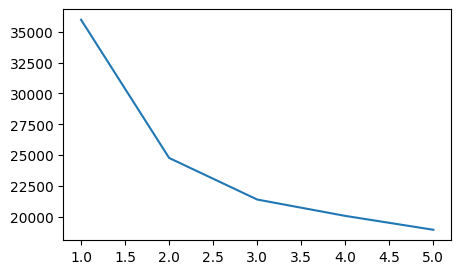

In [66]:
wcss = [] 
for number_of_clusters in range(1, 6): 
    kmeans = KMeans(n_clusters = number_of_clusters, random_state = 42)
    kmeans.fit(famd_transformed) 
    wcss.append(kmeans.inertia_)

ks = [1, 2, 3, 4, 5]
plt.plot(ks, wcss)

In [67]:
kmeans = KMeans(n_clusters=3)
kmeans.fit(famd_transformed)

labels = kmeans.labels_
kmeans_df = df.copy()
kmeans_df['clusters'] = labels


In [68]:
kmeans_df['clusters'].value_counts() / len(kmeans_df)

clusters
1    0.456975
2    0.279438
0    0.263587
Name: count, dtype: float64

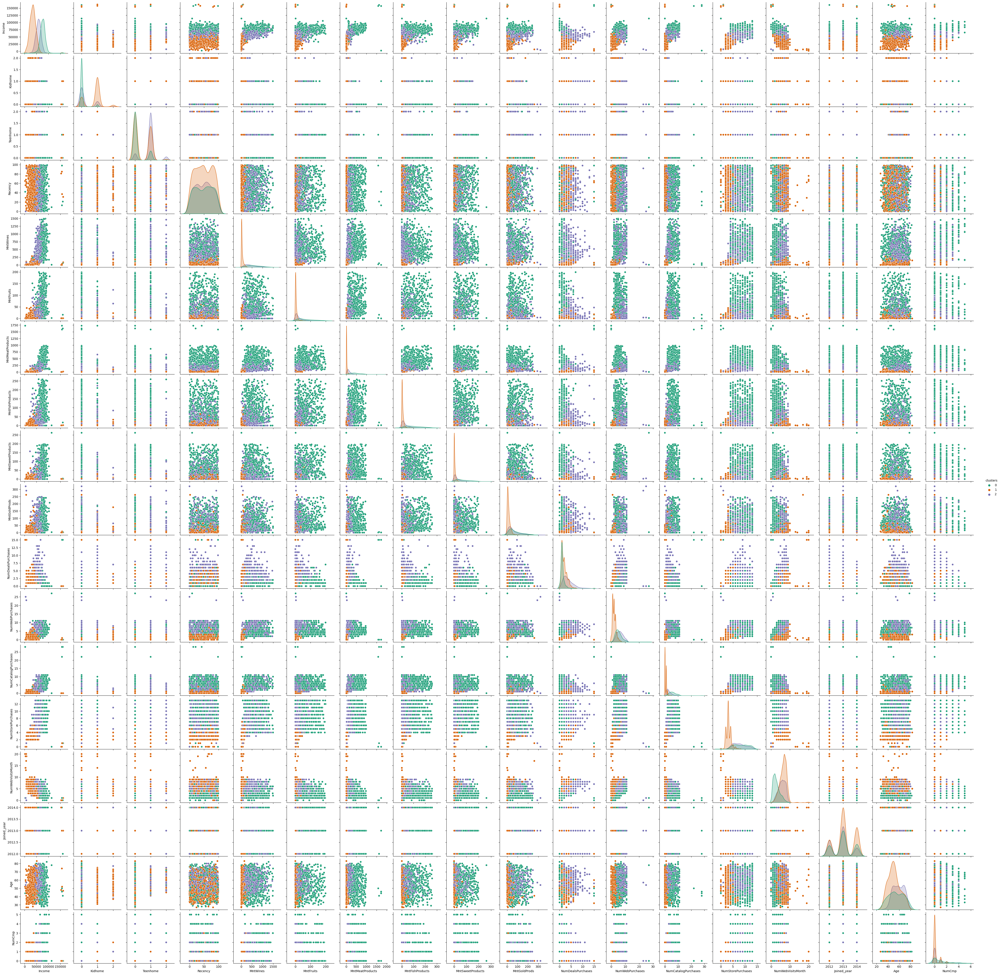

In [69]:
sns.pairplot(kmeans_df,hue='clusters',palette='Dark2')

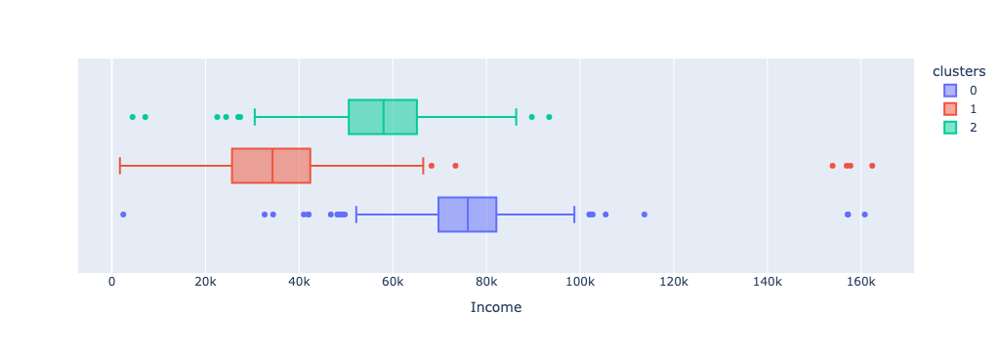

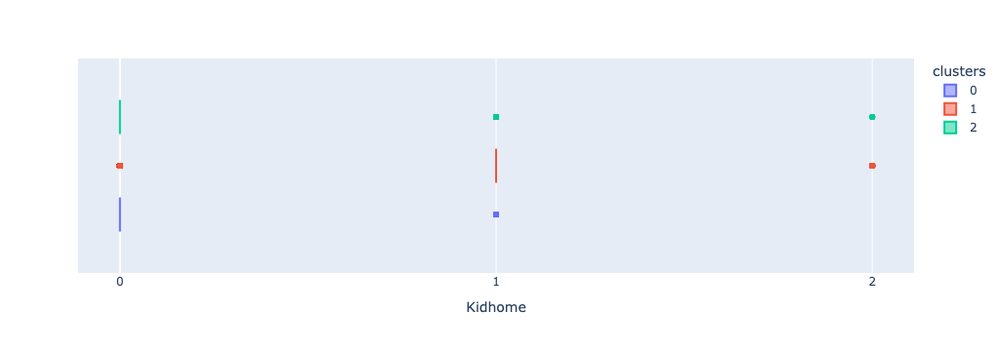

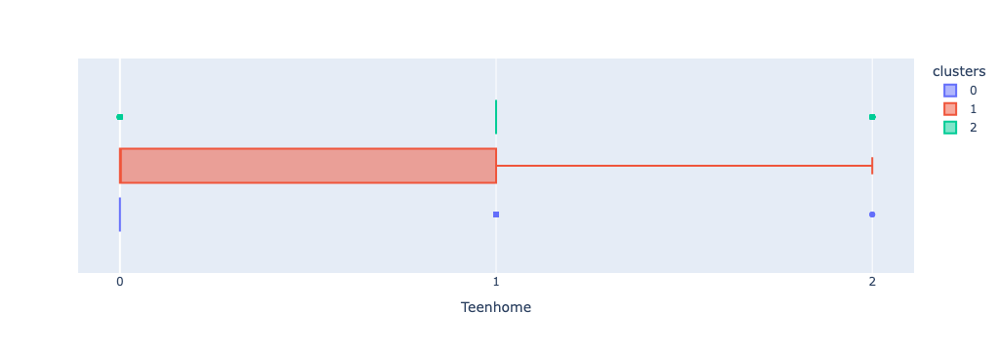

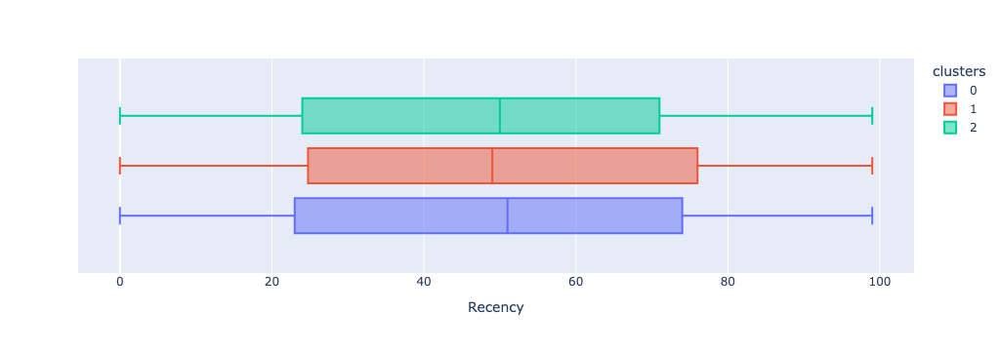

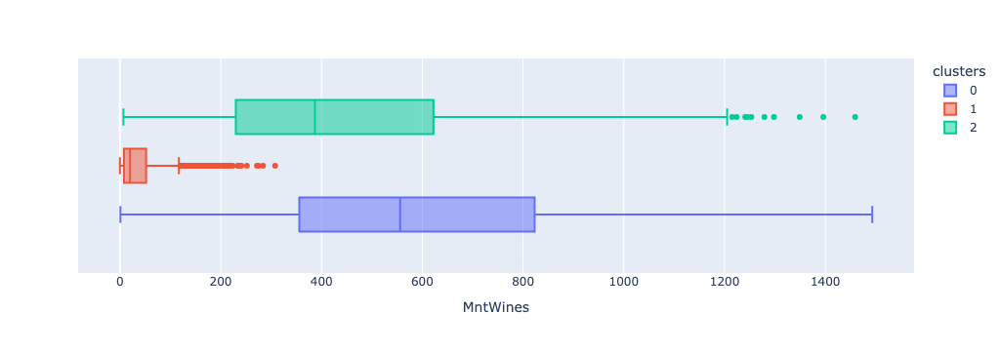

...

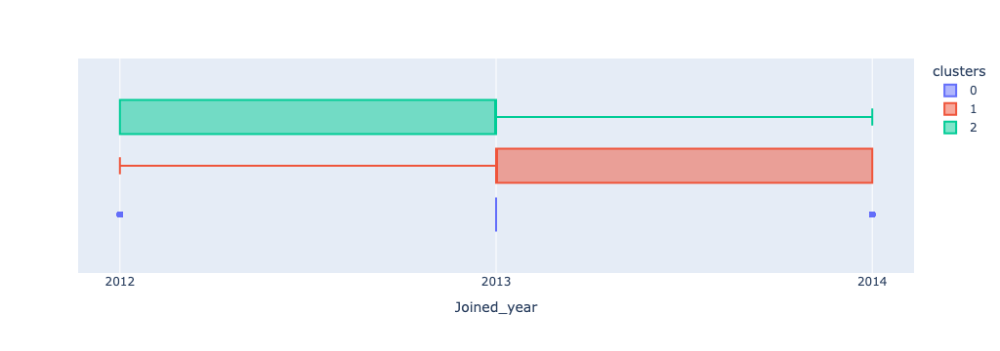

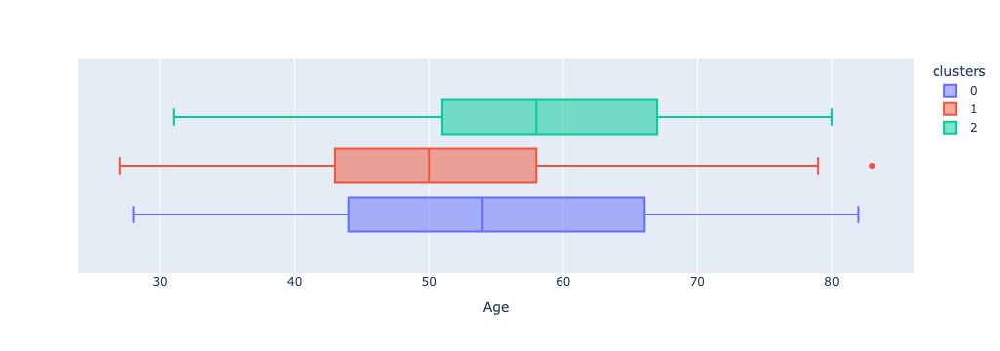

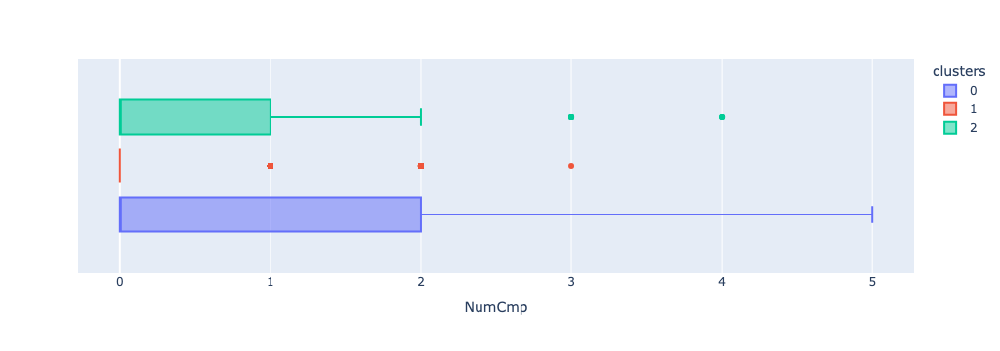

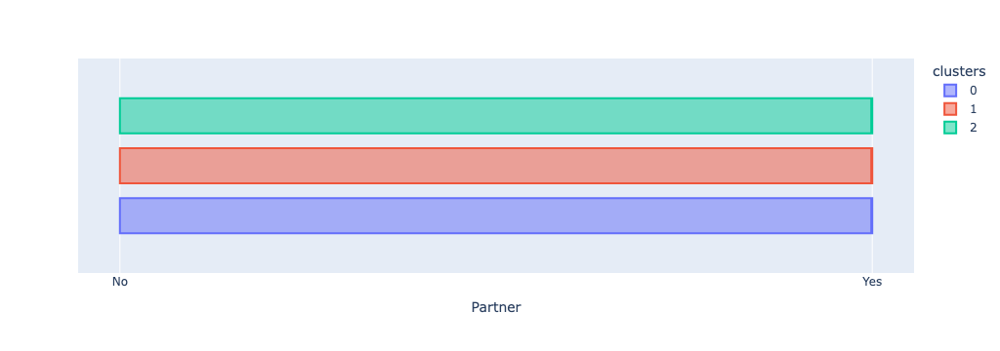

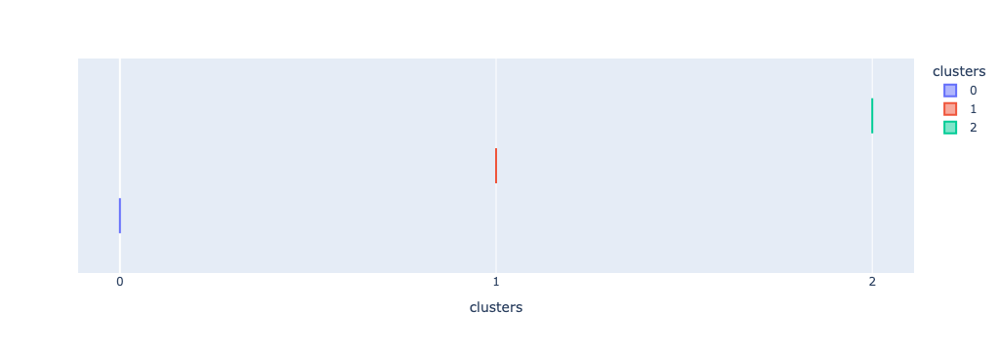

In [70]:
kmeans_df.sort_values(by=['clusters'], inplace=True)
for i in kmeans_df.columns:
    fig = px.box(kmeans_df, x=i, color="clusters")

    if len(kmeans_df[i].unique()) < 5:
        fig.update_layout(
            xaxis = dict(
                tickmode = 'array',
                tickvals = kmeans_df[i].unique(),
                ticktext = kmeans_df[i].unique()
            )
        )
        
    fig.show()


### DBSCAN

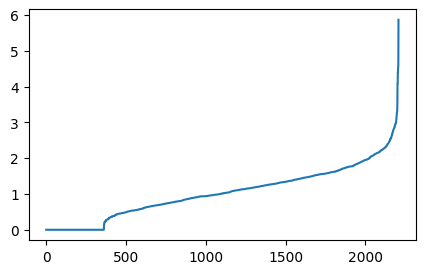

In [71]:
#selection of eps value
from sklearn.neighbors import NearestNeighbors

neighb = NearestNeighbors(n_neighbors=2) # creating an object of the NearestNeighbors class
nbrs=neighb.fit(famd_transformed) # fitting the data to the object
distances,indices=nbrs.kneighbors(famd_transformed) # finding the nearest neighbours

# Sort and plot the distances results
distances = np.sort(distances, axis = 0) # sorting the distances
distances = distances[:, 1] # taking the second column of the sorted distances
plt.rcParams['figure.figsize'] = (5,3) # setting the figure size
plt.plot(distances) # plotting the distances
plt.show() # showing the plot

len(famd_transformed.columns)

In [72]:
from sklearn.cluster import DBSCAN
db = DBSCAN(eps = 3,min_samples=20).fit(famd_transformed)
labels = db.labels_
set(labels)

{-1, 0}

### Agglomerative clustering

In [73]:
for i in range(2,6):
    clustering_model = AgglomerativeClustering(n_clusters=i).fit(famd_transformed)
    clusters = clustering_model.labels_
    unique, counts = np.unique(clusters, return_counts=True)
    value = dict(zip(unique, counts))
    print(i, metrics.calinski_harabasz_score(famd_transformed, clusters))
    print('   no. of customers in each cluster:', value)

2 915.1892813339524
   no. of customers in each cluster: {0: 1064, 1: 1144}
3 650.2187585197588
   no. of customers in each cluster: {0: 1144, 1: 614, 2: 450}
4 504.04777951920096
   no. of customers in each cluster: {0: 841, 1: 614, 2: 450, 3: 303}
5 431.1877756839193
   no. of customers in each cluster: {0: 614, 1: 301, 2: 450, 3: 303, 4: 540}


### Meanshift

In [74]:
meanshift = MeanShift().fit(famd_transformed)
clusters = meanshift.labels_

unique, counts = np.unique(clusters, return_counts=True)
value = dict(zip(unique, counts))
print('no. of customers in each cluster:', value)

no. of customers in each cluster: {0: 2165, 1: 3, 2: 40}


## Choosing the best model

In [75]:
df.columns

Index(['Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'Joined_year', 'Age', 'NumCmp', 'Partner'],
      dtype='object')

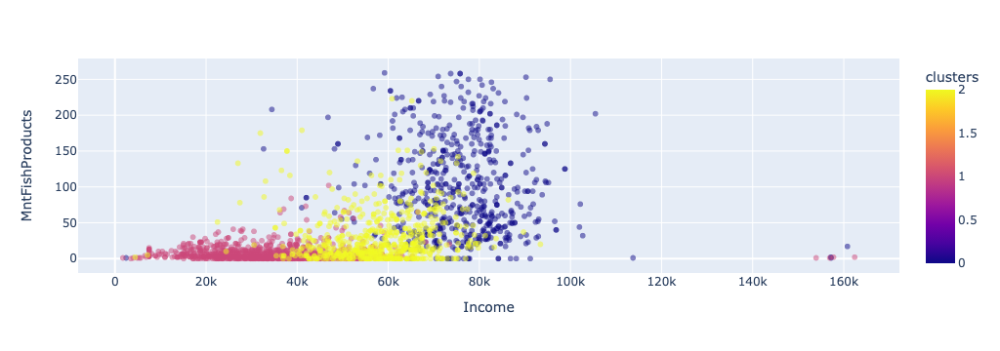

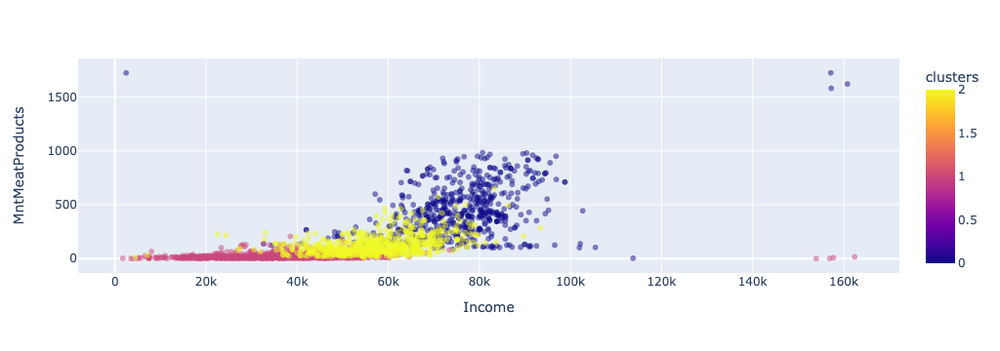

In [84]:
for i in ['MntFishProducts',
       'MntMeatProducts']:

    fig = px.scatter(kmeans_df, x="Income", y=i, color="clusters", opacity=0.5)
    fig.show()

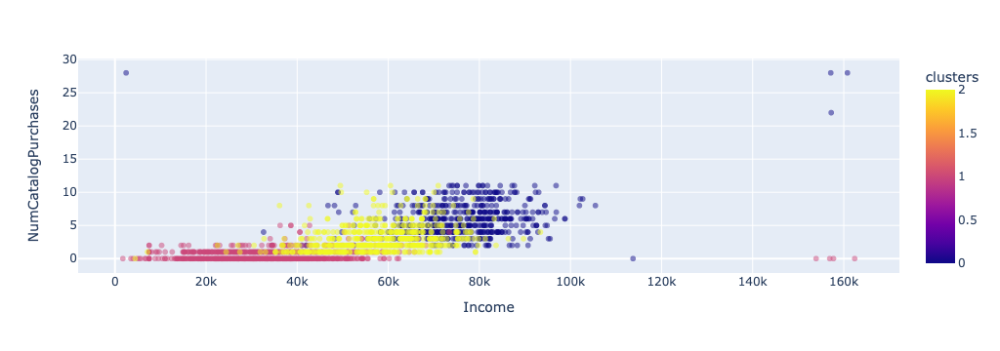

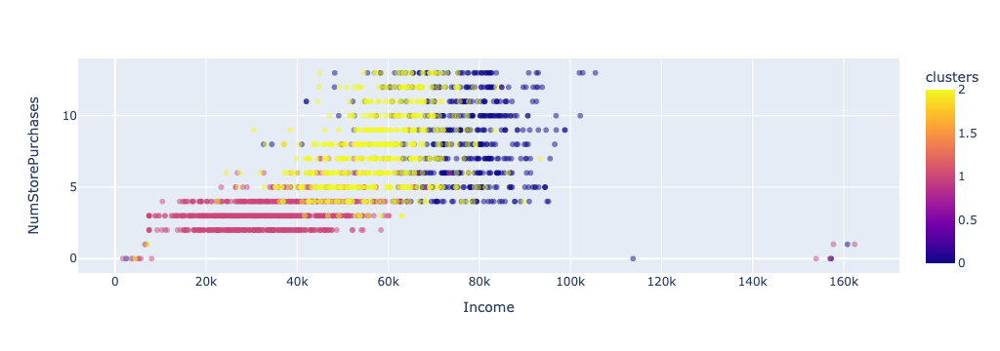

In [77]:
for i in [
       'NumCatalogPurchases', 'NumStorePurchases']:

    fig = px.scatter(kmeans_df, x="Income", y=i, color="clusters", opacity=0.5)
    fig.show()

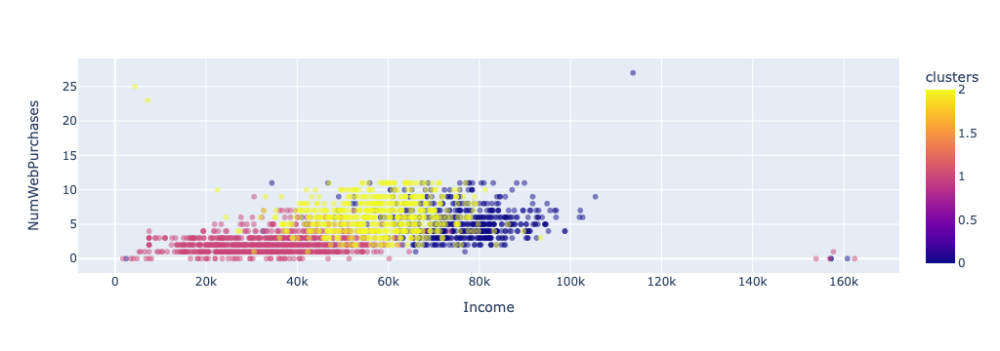

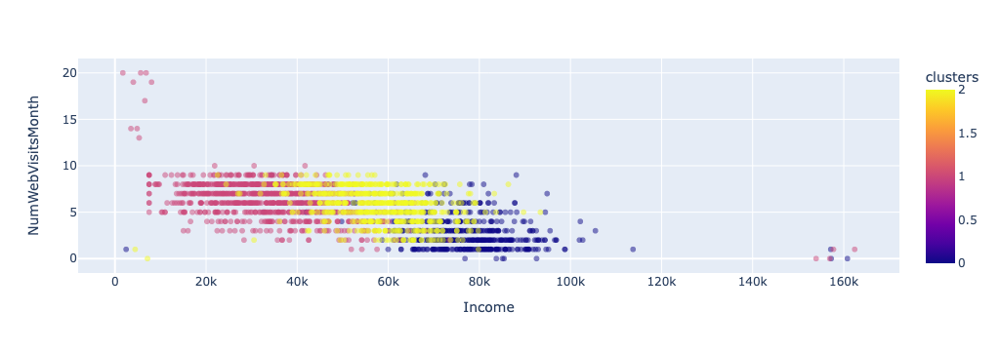

In [78]:
for i in [ 'NumWebPurchases', 'NumWebVisitsMonth']:

    fig = px.scatter(kmeans_df, x="Income", y=i, color="clusters", opacity=0.5)
    fig.show()

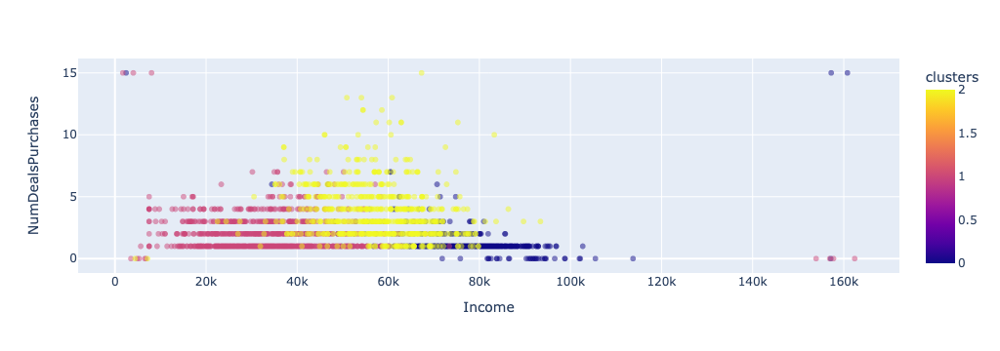

In [79]:
for i in [ 'NumDealsPurchases']:

    fig = px.scatter(kmeans_df, x="Income", y=i, color="clusters", opacity=0.5)
    fig.show()

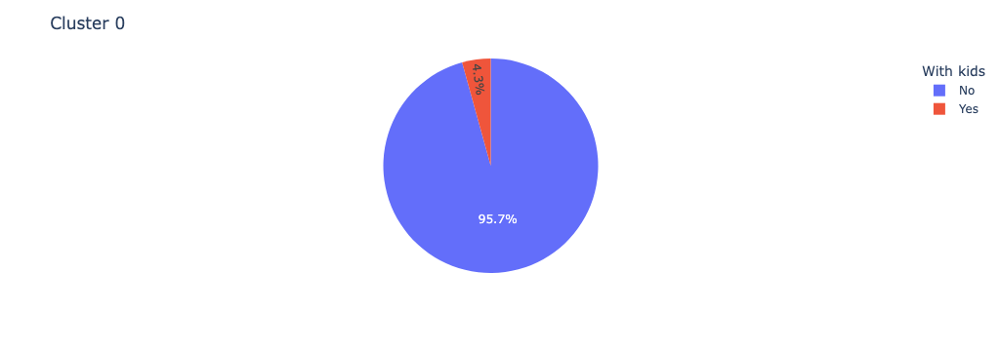

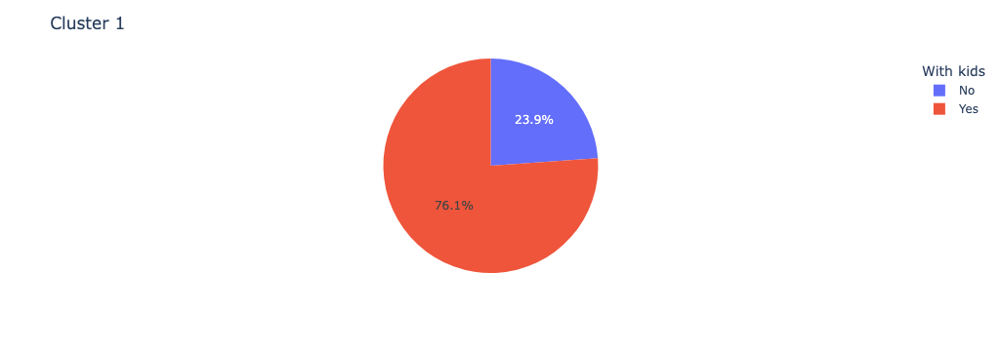

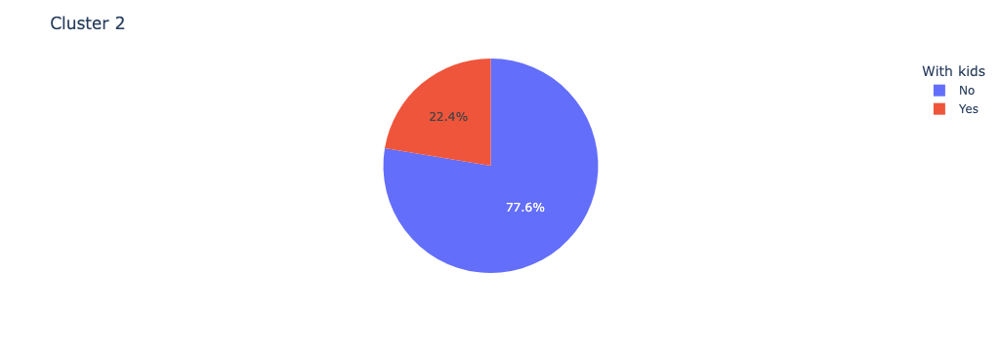

In [80]:
# Kids
for i in [0,1,2]:
    temp = kmeans_df[kmeans_df['clusters'] == i]
    temp['present'] = np.where(temp['Kidhome'] ==0 , 'No','Yes')
    grouping = temp[['present','Age']].groupby(by=["present"]).count()
    grouping.reset_index(inplace=True)

    fig = px.pie(grouping, values='Age', names='present', category_orders={"present": ["No","Yes"]})
    
    fig.update_layout(
    legend=dict(title="With kids"),
    title = f"Cluster {i}")
    fig.show()


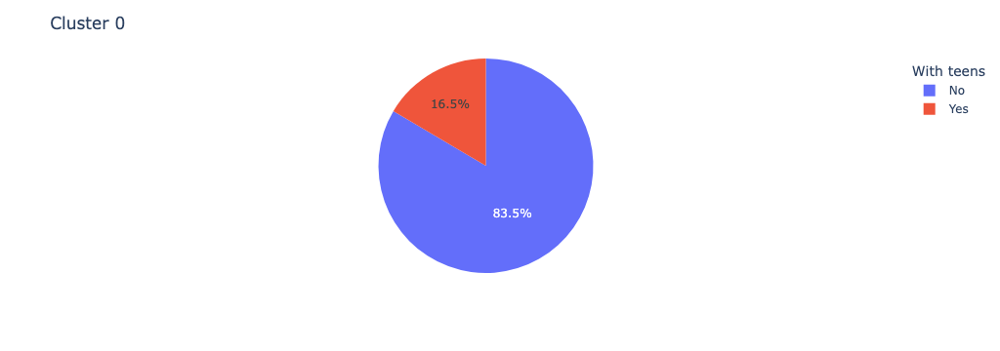

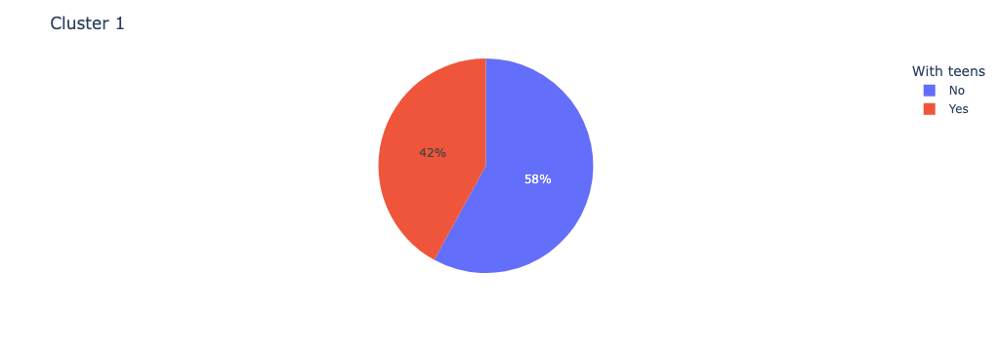

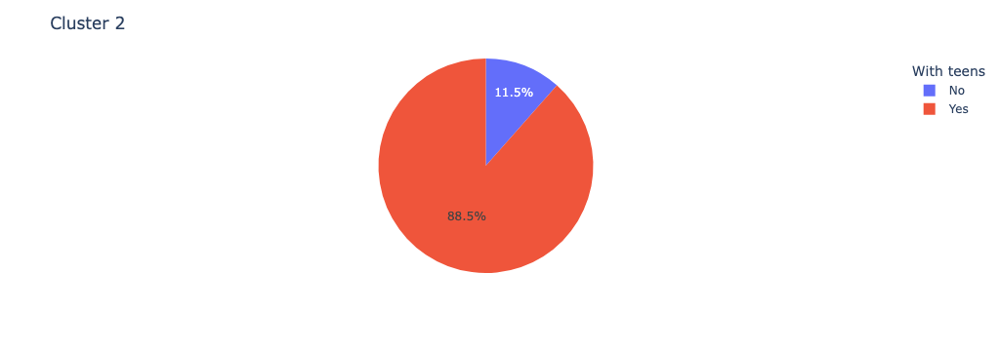

In [81]:
# Teens
for i in [0,1,2]:
    temp = kmeans_df[kmeans_df['clusters'] == i]
    temp['present'] = np.where(temp['Teenhome'] ==0 , 'No','Yes')
    grouping = temp[['present','Age']].groupby(by=["present"]).count()
    grouping.reset_index(inplace=True)

    fig = px.pie(grouping, values='Age', names='present', category_orders={"present": ["No","Yes"]})
    
    fig.update_layout(
    legend=dict(title="With teens"),
    title = f"Cluster {i}")
    fig.show()


In [82]:
kmeans_df['clusters'].value_counts()

clusters
1    1009
2     617
0     582
Name: count, dtype: int64

In [83]:
# for i in ['MntWines', 'MntFruits',
#        'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
#        'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
#        'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth']:

#     fig = px.scatter(kmeans_df, x="Income", y=i, color="clusters", opacity=0.5)
#     fig.show()